In [1]:
# load all necessary libraries and set matplotlib magic command
import time
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
import geopandas as gpd
import warnings
import itertools 
import scipy.stats as stats
import xgboost as xgb
import plotly.express as px

from itertools import islice 
from time import time
from operator import itemgetter
from tqdm import tqdm
from matplotlib.patches import Patch
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
from scipy.spatial import cKDTree
from shapely.geometry import Point, MultiPoint, LineString
from shapely.ops import nearest_points

from sklearn.preprocessing import PowerTransformer, StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.svm import SVC, l1_min_c
from sklearn import linear_model
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import LassoCV, LinearRegression
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture as GMM
from sklearn.metrics import classification_report, confusion_matrix, plot_confusion_matrix, silhouette_score, mean_squared_error, mean_absolute_error, r2_score, max_error
from sklearn.feature_selection import RFECV, SelectFromModel
from sklearn.model_selection import StratifiedKFold, train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import PowerTransformer, StandardScaler
from sklearn.base import BaseEstimator

from yellowbrick.regressor import ResidualsPlot, PredictionError
from xgboost.sklearn import XGBRegressor

from keras.wrappers.scikit_learn import KerasRegressor
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten

pd.set_option('display.float_format', '{:.3f}'.format)
sns.set(font_scale=1.3)
warnings.filterwarnings("ignore")
plt.style.use('seaborn-white')
%matplotlib inline

C:\Anaconda\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
Using TensorFlow backend.


# Introduction

The resale flat prices dataset from [data.gov](https://data.gov.sg/dataset/resale-flat-prices) will be used for this project. Data from year 2015 to 2020 is used for visualisation and both supervised and unsupervised learning, with the end goal of developing a regression or classification model to predict resale flat prices or flat type based on the features within this dataset and the features generated from other sources or from both.

In [2]:
# Read the dataset and pick out the csv files that contains data from 2015 onwards
hdb_df1 = pd.read_csv("dataset/resale-flat-prices-based-on-registration-date-from-jan-2017-onwards.csv")
hdb_df2 = pd.read_csv("dataset/resale-flat-prices-based-on-registration-date-from-jan-2015-to-dec-2016.csv")
hdb_df = hdb_df1.append(hdb_df2)

In [3]:
hdb_df.head()

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,remaining_lease,resale_price
0,2017-01,ANG MO KIO,2 ROOM,406,ANG MO KIO AVE 10,10 TO 12,44.000,Improved,1979,61 years 04 months,232000.000
1,2017-01,ANG MO KIO,3 ROOM,108,ANG MO KIO AVE 4,01 TO 03,67.000,New Generation,1978,60 years 07 months,250000.000
2,2017-01,ANG MO KIO,3 ROOM,602,ANG MO KIO AVE 5,01 TO 03,67.000,New Generation,1980,62 years 05 months,262000.000
3,2017-01,ANG MO KIO,3 ROOM,465,ANG MO KIO AVE 10,04 TO 06,68.000,New Generation,1980,62 years 01 month,265000.000
4,2017-01,ANG MO KIO,3 ROOM,601,ANG MO KIO AVE 5,01 TO 03,67.000,New Generation,1980,62 years 05 months,265000.000


In [4]:
# Check for duplicated rows
hdb_df.duplicated().sum() 

541

In [5]:
# Remove duplicated rows
hdb_df.drop_duplicates(inplace=True) 

In [6]:
# Check for null entries
hdb_df.isnull().sum() 

month                  0
town                   0
flat_type              0
block                  0
street_name            0
storey_range           0
floor_area_sqm         0
flat_model             0
lease_commence_date    0
remaining_lease        0
resale_price           0
dtype: int64

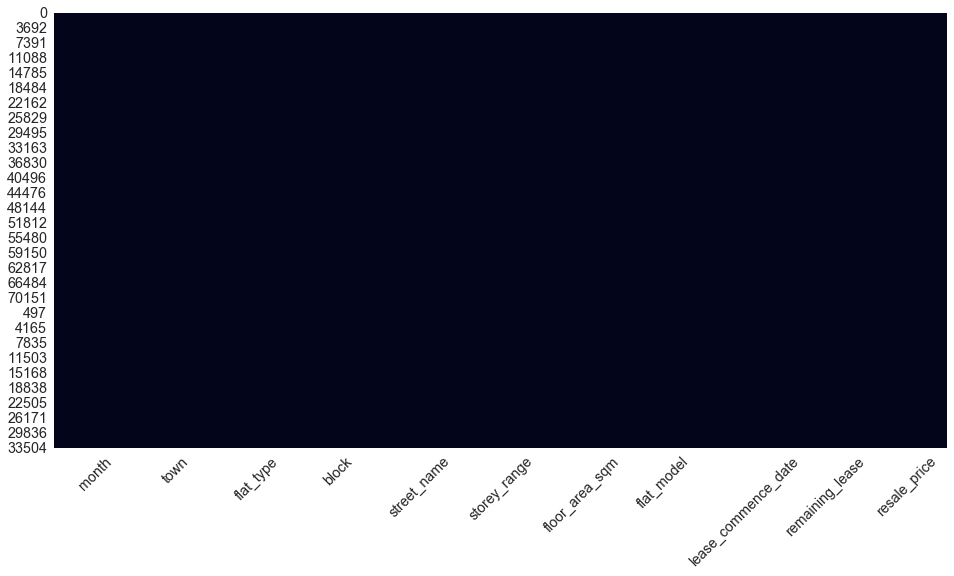

In [7]:
fig, ax = plt.subplots(figsize=(16,8))
ax = sns.heatmap(hdb_df.isnull(), cbar=False); plt.xticks(rotation=45);

#### Geocoding

The exact locations for each flat can be derived from the address using the geopy library to make API calls to Google Maps in order to grab the latitude and longitude coordinates for each flat, which can be plotted on a map.

In [8]:
# We can get the coordinates of the resale flat using geocoding
locator = Nominatim(user_agent='myGeocoder')
location = locator.geocode('Bedok Reservoir Road, Bedok, Northeast, 470703, Singapore')

In [9]:
location

Location(Bedok Reservoir Road, Bedok, Northeast, 470703, Singapore, (1.3374245, 103.9200235, 0.0))

In [10]:
# Get the address of the flat with the block and street name
hdb_df['address'] = hdb_df.block + ' ' + hdb_df.street_name

#### Flat Heights

We will consider the following assumptions for HDB flats, as referenced from the [Singapore Public Housing Wiki](https://singaporepublichousing.fandom.com/wiki/HDB_unit_Elevation-Ground_floor,low_floor,mid-floor_and_high_floor):

* Ground and low floor units: 1st to 4th floors
* Mid-floor units: 5th to 8th floors
* High-floor units: 9th and above floors

In [11]:
hdb_df.storey_range.value_counts()

04 TO 06    25856
07 TO 09    23628
10 TO 12    20882
01 TO 03    20103
13 TO 15     9947
16 TO 18     4352
19 TO 21     1873
22 TO 24     1362
25 TO 27      730
28 TO 30      466
34 TO 36      204
31 TO 33      197
37 TO 39      192
40 TO 42       98
46 TO 48       20
43 TO 45       14
49 TO 51        8
Name: storey_range, dtype: int64

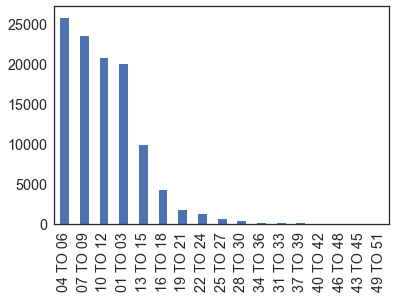

In [12]:
hdb_df.storey_range.value_counts().plot.bar();

In [13]:
def label_height (row):
   if row['storey_range'] == '01 TO 03':
      return 'Lowest'
   if row['storey_range'] == '04 TO 06':
      return 'Mid-Low'
   if row['storey_range'] == '07 TO 09':
      return 'Mid-High'
   if row['storey_range'] == '10 TO 12':
      return 'High'
   else:
      return 'Highest'

Generate a new `height` feature based on `storey_range` for each flat.

In [14]:
# Label the height of the HDB flat according to the above assumption
hdb_df['height'] = hdb_df.apply(lambda row: label_height(row), axis=1)

In [15]:
hdb_df.height.value_counts()

Mid-Low     25856
Mid-High    23628
High        20882
Lowest      20103
Highest     19463
Name: height, dtype: int64

We can run the entire dataset through the geocoder to obtain the exact coordinates for each flat.

In [16]:
# Use geopy to geocode the address with the location of the flat
# loc_list = []
# for add in tqdm(hdb_df['address']):
#     loc_list.append(locator.geocode(add))

In [17]:
# hdb_df['location'] = loc_list

In [18]:
# hdb_lat = []
# hdb_lon = []
# for i in tqdm(range(len(loc_list))):
#     try:
#         hdb_lat.append(loc_list[i].latitude)
#         hdb_lon.append(loc_list[i].longitude)
#     except AttributeError:
#         hdb_lat.append(0.0)
#         hdb_lon.append(0.0)

In [19]:
# hdb_df['Latitude'] = hdb_lat
# hdb_df['Longitude'] = hdb_lon

In [20]:
# Read processed file instead of geocoding again (takes very long)
hdb_df = pd.read_csv("dataset/hdb_df_from_2015_processed.csv").drop(columns='Unnamed: 0')

In [21]:
# Check for null values after geocoding addresses
hdb_df.isnull().sum() 

month                  0
town                   0
flat_type              0
block                  0
street_name            0
storey_range           0
floor_area_sqm         0
flat_model             0
lease_commence_date    0
remaining_lease        0
resale_price           0
address                0
height                 0
location               0
Latitude               0
Longitude              0
dtype: int64

In [22]:
hdb_df = hdb_df.dropna(subset=['location']) # Remove NoneTypes

In [23]:
hdb_df.height.value_counts()

Mid-Low     21845
Mid-High    20097
High        17837
Lowest      17020
Highest     16207
Name: height, dtype: int64

In [24]:
# Save file for future analysis
# hdb_df.to_csv('dataset/hdb_df_from_2015_processed.csv')

In [25]:
hdb_df = gpd.GeoDataFrame(hdb_df, geometry=gpd.points_from_xy(hdb_df.Longitude, hdb_df.Latitude))

Clean the data by removing invalid locations that are outside of Singapore.

In [26]:
# Pick only locations that are valid (within Singapore)
hdb_df = hdb_df[hdb_df['Latitude'].between(1.23, 1.48, inclusive=False)] 
hdb_df = hdb_df[hdb_df['Longitude'].between(103.56, 104.04, inclusive=False)] 

Extract only the year for remaining lease.

In [27]:
hdb_df.remaining_lease = hdb_df.remaining_lease.astype(str).str.extract('(\d+)').astype('int') 

Load different map files for visualisation.

In [28]:
nml_df = gpd.read_file("dataset/national-map-line-geojson.geojson")
mall_df = gpd.read_file("dataset/Shopping_Malls_Singapore.geojson")
ele_df = gpd.read_file("dataset/electoral-boundary-dataset.geojson")
mrt_df = gpd.read_file("dataset/singapore-mrt.geojson").dropna()
sgp_df = gpd.read_file("dataset/sg_map.geojson").dropna()

In [29]:
exp_df = nml_df[nml_df['Description'].str.contains("EXPRESSWAY")] 

Plotting the resale flat coordinates with the `matplotlib` library, we can visualise the locations of all the resale flats on a map with additional features like expressways, MRT stations and shopping malls. The distance to these points can become new features in our dataset, whereby we can obtain new insights from.

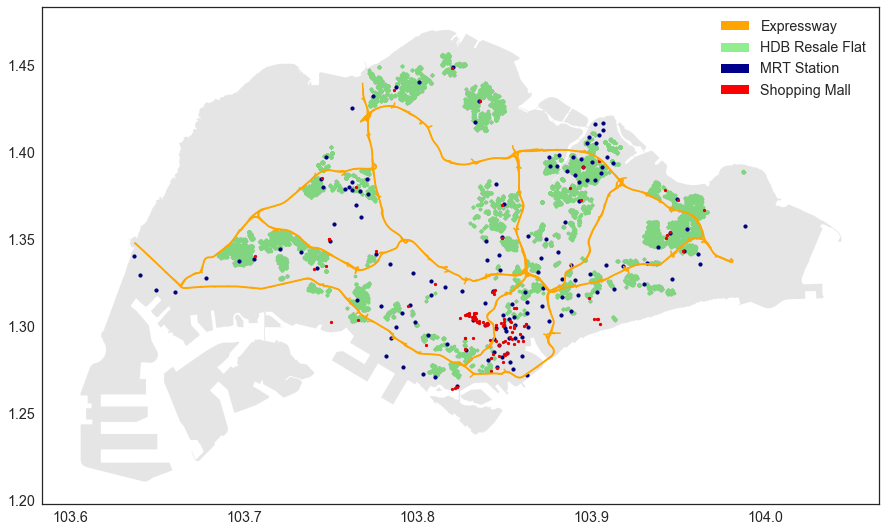

In [30]:
# Overlay the expressway map on top of the resale flats
fig, ax = plt.subplots(figsize=(15,10))
exp_df.plot(color='orange', ax=ax)
hdb_df.plot(color='lightgreen', markersize=5, ax=ax)
mrt_df.plot(color='darkblue', markersize=10, ax=ax)
mall_df.plot(color='red', markersize=5, ax=ax)
sgp_df.plot(color='black', alpha=0.1, ax=ax)
legend_elements = [Patch(facecolor='orange', label='Expressway'), Patch(facecolor='lightgreen', label='HDB Resale Flat'), Patch(facecolor='darkblue', label='MRT Station'), Patch(facecolor='red', label='Shopping Mall')]
ax.legend(handles=legend_elements, loc='upper right');

Using the unary_union function to create a MultiPoint object, we can draw the distance from a resale flat to the nearest feature.

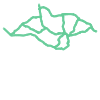

In [31]:
exp_mult = exp_df.unary_union # Creates a MultiPoint object from the Expressway geometries without buffer
exp_mult

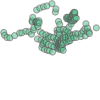

In [32]:
mrt_mult = mrt_df.unary_union # Creates a MultiPoint object from the MRT geometries without buffer
mrt_mult

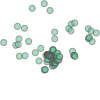

In [33]:
mall_mult = mall_df.unary_union # Creates a MultiPoint object from the shopping mall geometries without buffer
mall_mult

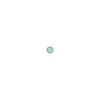

In [34]:
cbd_mult = mrt_df[mrt_df.name=='Raffles Place'].unary_union # Use Raffles Place MRT as city centre
cbd_mult

Get the straight-line distance from a resale flat's location to the nearest feature (expressway, MRT or mall).

In [35]:
hdb_df['dist_to_expressway'] = hdb_df.distance(exp_mult)
hdb_df['dist_to_mrt'] = hdb_df.distance(mrt_mult)
hdb_df['dist_to_mall'] = hdb_df.distance(mall_mult)
hdb_df['dist_to_cbd'] = hdb_df.distance(cbd_mult)

Reset index because dropping invalid and repeated entries messes up the original index.

In [36]:
hdb_df = hdb_df.reset_index(drop=True)

# Data Visualisation

A correlation heatmap is plotted to visualise relationships between features. 

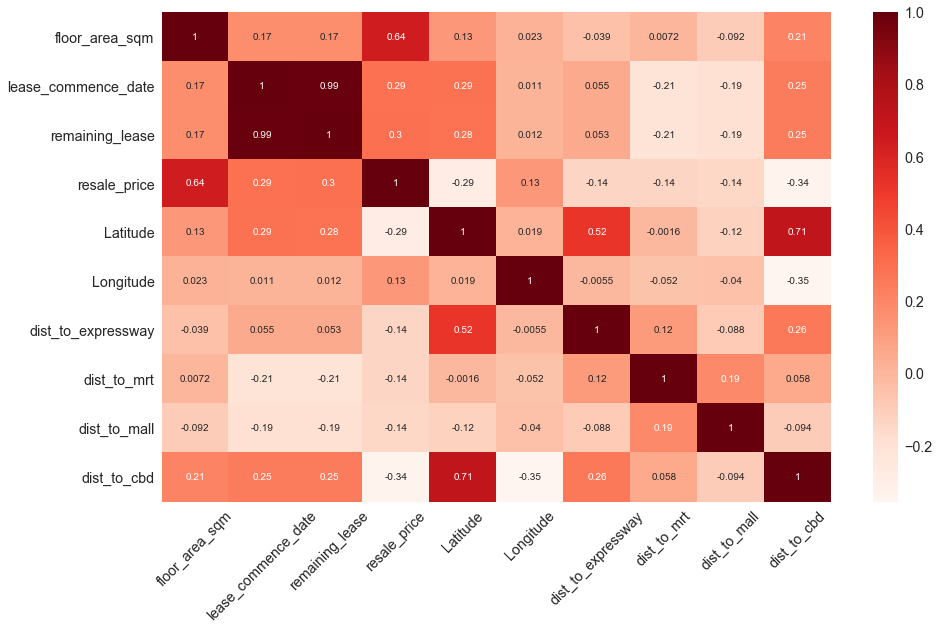

In [37]:
plt.figure(figsize=(15,9))
heatmap = sns.heatmap(hdb_df.corr(), annot = True,  cmap="Reds")
plt.xticks(rotation=45)
heatmap.set_ylim(len(hdb_df.corr()), 0);

The above heatmap shows that resale prices share a positive correlation with a flat's floor area, and have weak positive correlations with remaining lease period and commencement date. Distance to CBD has a negative correlation with resale prices, suggesting that the closer a flat is to the city centre, the more expensive it may be. Most of the other features are uncorrelated with resale prices.

In [38]:
hdb_df.head()

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,remaining_lease,...,address,height,location,Latitude,Longitude,geometry,dist_to_expressway,dist_to_mrt,dist_to_mall,dist_to_cbd
0,2017-01,ANG MO KIO,2 ROOM,406,ANG MO KIO AVE 10,10 TO 12,44.000,Improved,1979,61,...,406 ANG MO KIO AVE 10,High,"Ang Mo Kio Avenue 10, Ang Mo Kio, Singapore, C...",1.369,103.857,POINT (103.85678 1.36925),0.003,0.007,0.008,0.085
1,2017-01,ANG MO KIO,3 ROOM,108,ANG MO KIO AVE 4,01 TO 03,67.000,New Generation,1978,60,...,108 ANG MO KIO AVE 4,Lowest,"Ang Mo Kio Avenue 4, Ang Mo Kio, Singapore, Ce...",1.370,103.837,POINT (103.83668 1.37044),0.023,0.013,0.012,0.087
2,2017-01,ANG MO KIO,3 ROOM,602,ANG MO KIO AVE 5,01 TO 03,67.000,New Generation,1980,62,...,602 ANG MO KIO AVE 5,Lowest,"602, Ang Mo Kio Avenue 5, Ang Mo Kio, Singapor...",1.380,103.836,POINT (103.83565 1.38049),0.013,0.009,0.017,0.097
3,2017-01,ANG MO KIO,3 ROOM,465,ANG MO KIO AVE 10,04 TO 06,68.000,New Generation,1980,62,...,465 ANG MO KIO AVE 10,Mid-Low,"465, Ang Mo Kio Avenue 10, Ang Mo Kio, Singapo...",1.366,103.857,POINT (103.85718 1.36621),0.003,0.009,0.009,0.082
4,2017-01,ANG MO KIO,3 ROOM,601,ANG MO KIO AVE 5,01 TO 03,67.000,New Generation,1980,62,...,601 ANG MO KIO AVE 5,Lowest,"Ang Mo Kio Avenue 5, Ang Mo Kio, Singapore, Ce...",1.377,103.838,POINT (103.83833 1.37703),0.017,0.008,0.013,0.094


In [39]:
colorlist = sns.color_palette("Set2")
colorlist_pie = sns.color_palette("Pastel1")

We can perform some basic visualisations with the cleaned dataset. For the below figure, the distribution of HDB flats per town is plotted. Jurong West, Sengkang, Yishun, Woodlands and Tampines represent the towns were most resale flats were purchased.

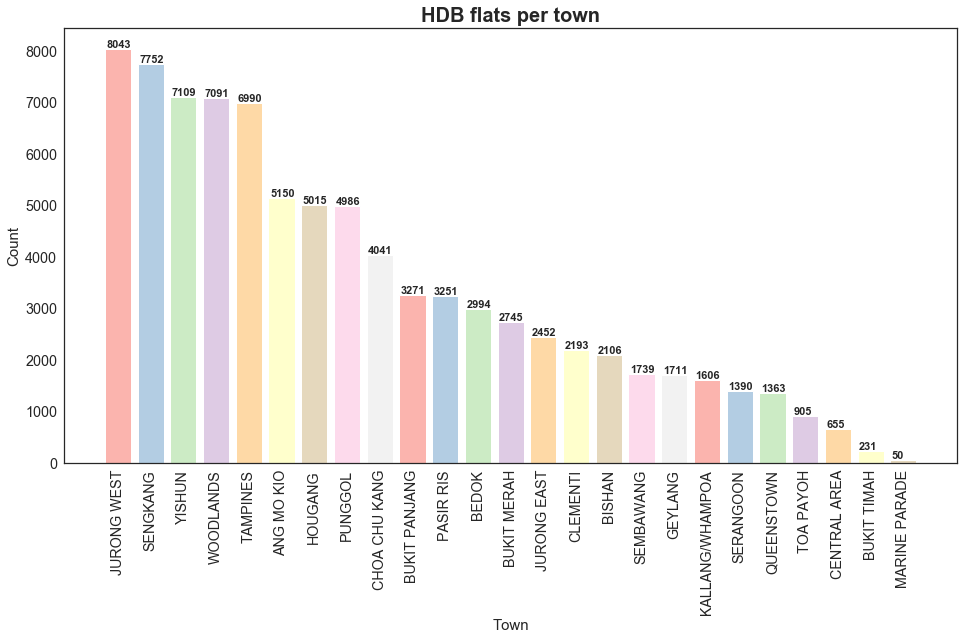

In [40]:
fig, ax = plt.subplots(figsize=(16, 8))
ax.bar(hdb_df.town.value_counts().index, hdb_df.town.value_counts().values, color=colorlist_pie)
plt.title('HDB flats per town', fontsize=20, fontweight='bold') 
plt.xlabel('Town', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.xticks(rotation=90)
for i, v in enumerate(hdb_df.town.value_counts().values):
    ax.text(i-0.35, hdb_df.town.value_counts().values[i]+20, "%.f" % v, fontsize=11, fontweight='bold');

Most of the flats sold were 4-room flats, followed by 5-room and 3-room flats, as seen in the pie chart below.

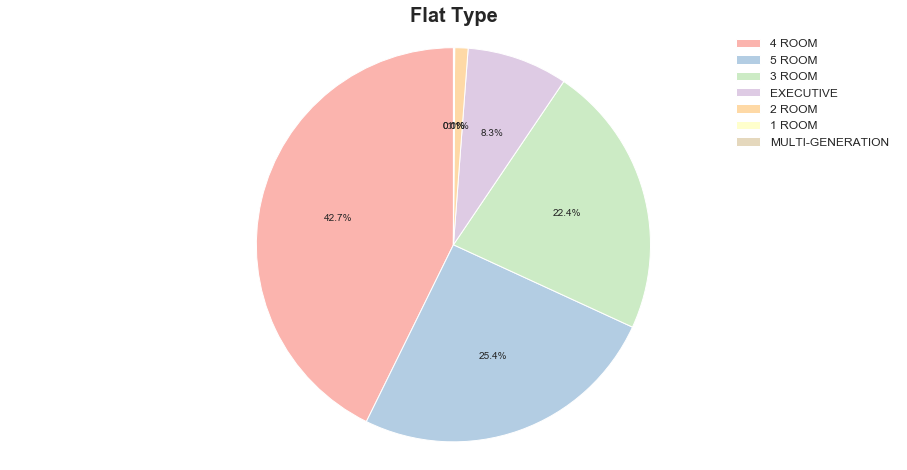

In [41]:
fig1, ax1 = plt.subplots(figsize=(16,8))
labels = hdb_df.flat_type.value_counts().index.tolist()
ax1.pie(hdb_df.flat_type.value_counts().values, autopct='%1.1f%%', shadow=False, startangle=90, colors=colorlist_pie)
plt.title('Flat Type', fontsize=20, fontweight='bold')
plt.legend(labels, loc='left center', fontsize=12)
ax1.axis('equal')  
plt.show();

From the below bar plot, 'Model A', 'Improved' and 'New Generation' forms the majority of flat models. 

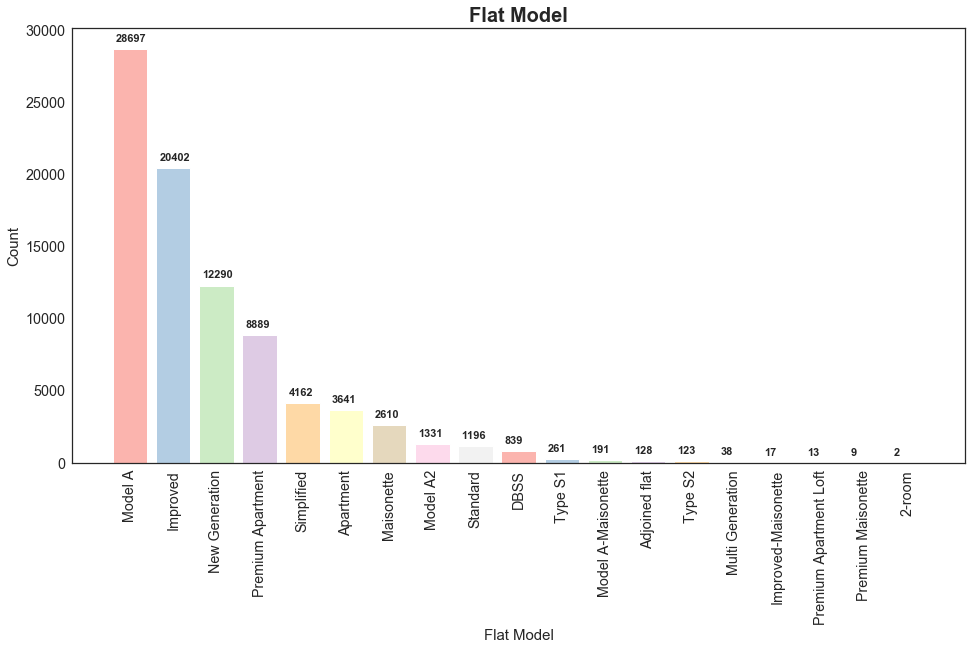

In [42]:
fig, ax = plt.subplots(figsize=(16, 8))
ax.bar(hdb_df.flat_model.value_counts().index, hdb_df.flat_model.value_counts().values, color=colorlist_pie)
plt.title('Flat Model', fontsize=20, fontweight='bold') 
plt.xlabel('Flat Model', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.xticks(rotation=90)
for i, v in enumerate(hdb_df.flat_model.value_counts().values):
    ax.text(i-0.32, hdb_df.flat_model.value_counts().values[i]+500, "%.f" % v, fontsize=11, fontweight='bold');

The below plots visualises the distributions of remaining lease, resale prices and floor area.

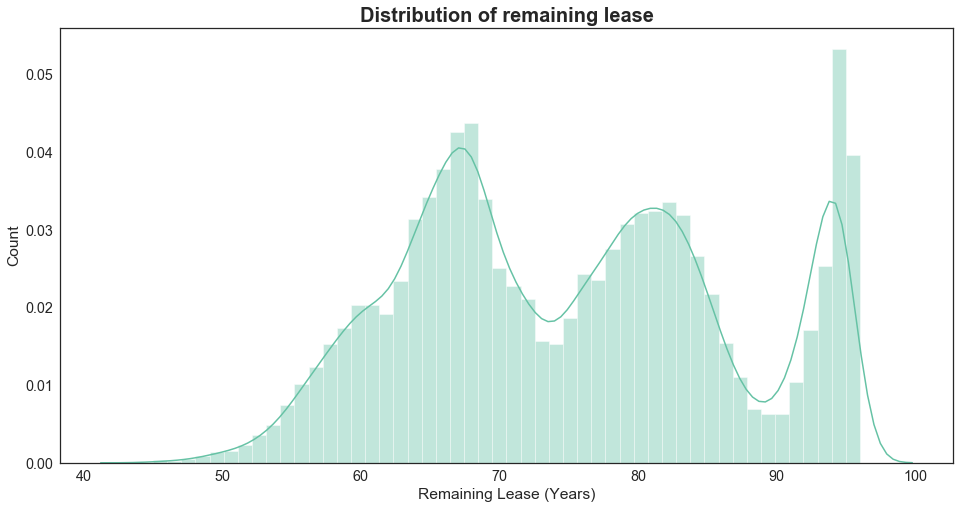

In [43]:
plt.subplots(figsize=(16,8))
sns.distplot(hdb_df.remaining_lease, hist = True, kde = True, color=colorlist[0])
plt.title('Distribution of remaining lease', fontweight="bold", fontsize=20)
plt.xlabel('Remaining Lease (Years)')
plt.ylabel('Count');

In [44]:
print(str(hdb_df.remaining_lease.describe())+'\n')
print('Mode = '+str(hdb_df.remaining_lease.mode()[0]))

count   84839.000
mean       75.088
std        11.507
min        45.000
25%        66.000
50%        75.000
75%        83.000
max        96.000
Name: remaining_lease, dtype: float64

Mode = 94


Remaining lease has a multimodal distribution with three different peaks showing the frequency of flats in a particular age group. Most resale flats have a high remaining number of years left in the lease at 94 years, suggesting that people tend to sell their flats early to reap profits gained through property appreciation.

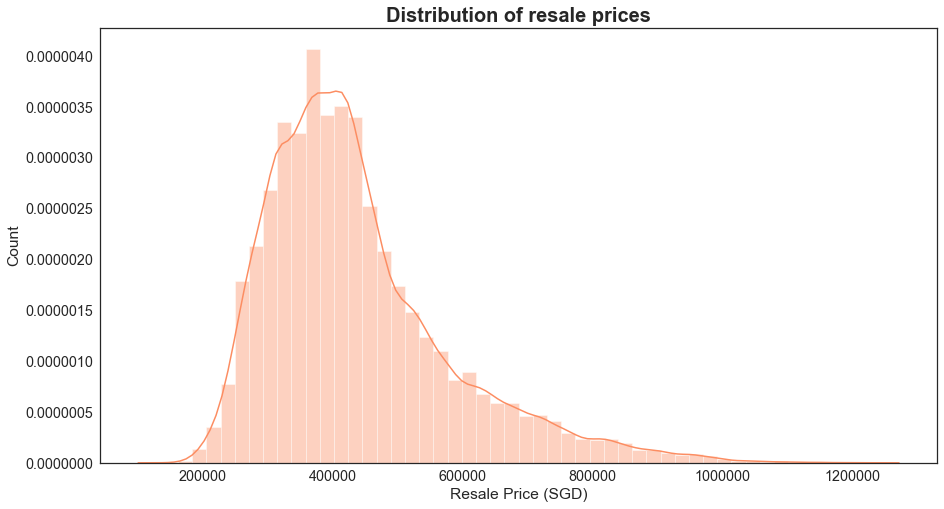

In [45]:
plt.subplots(figsize=(15,8))
sns.distplot(hdb_df.resale_price, hist = True, kde = True, color=colorlist[1])
plt.title('Distribution of resale prices', fontweight="bold", fontsize=20)
plt.xlabel('Resale Price (SGD)')
plt.ylabel('Count');

In [46]:
print(str(hdb_df.resale_price.describe())+'\n')
print('Mode = '+str(hdb_df.resale_price.mode()[0]))

count     84839.000
mean     437214.223
std      142518.411
min      140000.000
25%      338000.000
50%      410000.000
75%      500000.000
max     1232000.000
Name: resale_price, dtype: float64

Mode = 380000.0


Resale prices is right-skewed (positively-skewed) as the mean is higher than the median with outliers running into the SGD 1,000,000 range. The median flat price seems to be in the SGD 400,000 range, which is close to the price that most flats are sold at (SGD 380,000).

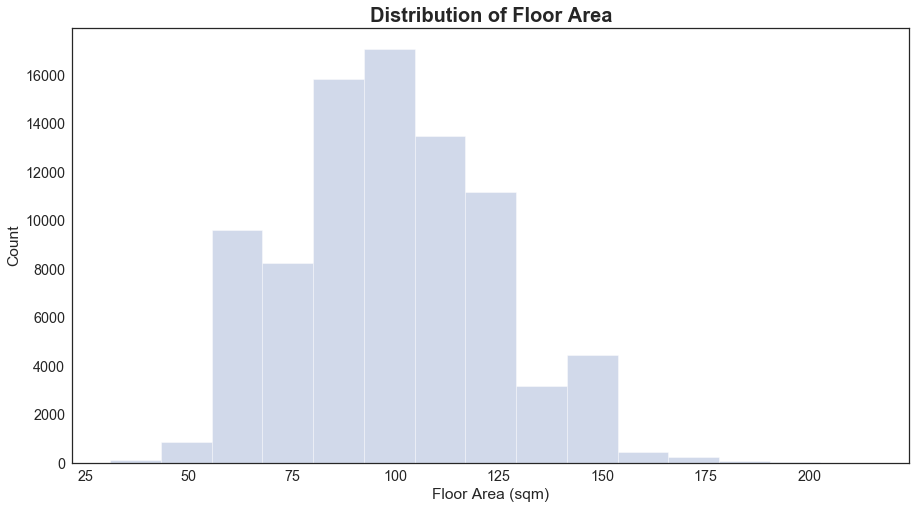

In [47]:
plt.subplots(figsize=(15,8))
sns.distplot(hdb_df.floor_area_sqm, hist = True, kde = False, color=colorlist[2], bins=15)
plt.title('Distribution of Floor Area', fontweight="bold", fontsize=20)
plt.xlabel('Floor Area (sqm)')
plt.ylabel('Count');

In [48]:
print(str(hdb_df.floor_area_sqm.describe())+'\n')
print('Mode = '+str(hdb_df.floor_area_sqm.mode()[0]))

count   84839.000
mean       99.134
std        23.741
min        31.000
25%        84.000
50%       100.000
75%       113.000
max       215.000
Name: floor_area_sqm, dtype: float64

Mode = 67.0


Floor area distribution seems to have a normal distribution since the median and mean are close to each other at 100sqm.

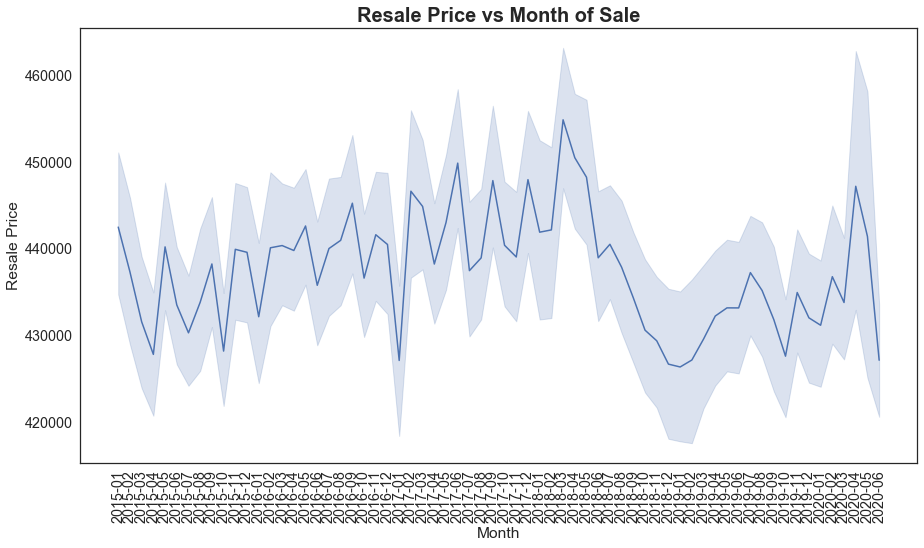

In [49]:
plt.subplots(figsize=(15,8))
sns.lineplot(x='month', y='resale_price', data=hdb_df)
plt.title("Resale Price vs Month of Sale", fontweight="bold", fontsize=20)
plt.xticks(rotation=90); plt.xlabel('Month'); plt.ylabel('Resale Price');

Plotting out the median resale prices for each month on a line plot shows the trend of resale prices over each month of each year from January 2015 to June 2020. Generally, resale prices are cyclical over the year but follows an upward trend from the start of 2015 to the middle of 2018 before dropping from July 2018 onwards. This is likely due to property cooling measures from the implementation of Additional Buyer’s Stamp Duty (ABSD) to reduce increasing HDB property prices in Singapore.

When different features are plotted against resale prices, we can visualise their relationships with the resale value of a flat.

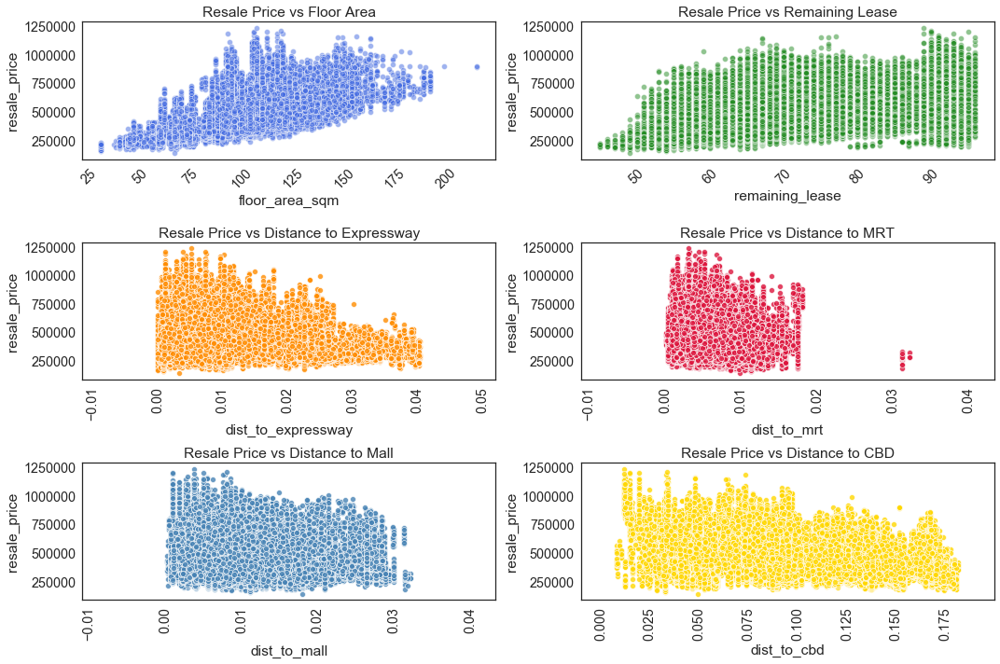

In [50]:
fig=plt.figure(figsize=(15, 10))
plt.subplot(321)
plt.title("Resale Price vs Floor Area")
plt.xticks(rotation=45)
sns.scatterplot(x='floor_area_sqm', y='resale_price', data=hdb_df, color='royalblue', alpha=0.5)

plt.subplot(322)
plt.title("Resale Price vs Remaining Lease")
plt.xticks(rotation=45)
sns.scatterplot(x='remaining_lease', y='resale_price', data=hdb_df, color='forestgreen', alpha=0.5)

plt.subplot(323)
plt.title("Resale Price vs Distance to Expressway")
plt.xticks(rotation=90)
sns.scatterplot(x='dist_to_expressway', y='resale_price', data=hdb_df, color='darkorange', alpha=0.8)

plt.subplot(324)
plt.title("Resale Price vs Distance to MRT")
plt.xticks(rotation=90)
sns.scatterplot(x='dist_to_mrt', y='resale_price', data=hdb_df, color='crimson', alpha=0.8)

plt.subplot(325)
plt.title("Resale Price vs Distance to Mall")
plt.xticks(rotation=90)
sns.scatterplot(x='dist_to_mall', y='resale_price', data=hdb_df, color='steelblue', alpha=0.8)

plt.subplot(326)
plt.title("Resale Price vs Distance to CBD")
plt.xticks(rotation=90)
sns.scatterplot(x='dist_to_cbd', y='resale_price', data=hdb_df, color='gold', alpha=0.8)

fig.tight_layout();

Resale flat prices have the strongest positive correlation of 0.64 with floor area, and this is reflected in the positive trend in the scatterplot. It also has a weak, positive correlation of 0.3 with remaining lease, and the positive trend is also shown in the scatterplot.

For the distances to expressway, MRT and mall, the resale prices seems to be generally uncorrelated. Distance to CBD has a weak, negative correlation of -0.34 which is reflected in the range of higher prices seen in resale flats when they are closer to the CBD.

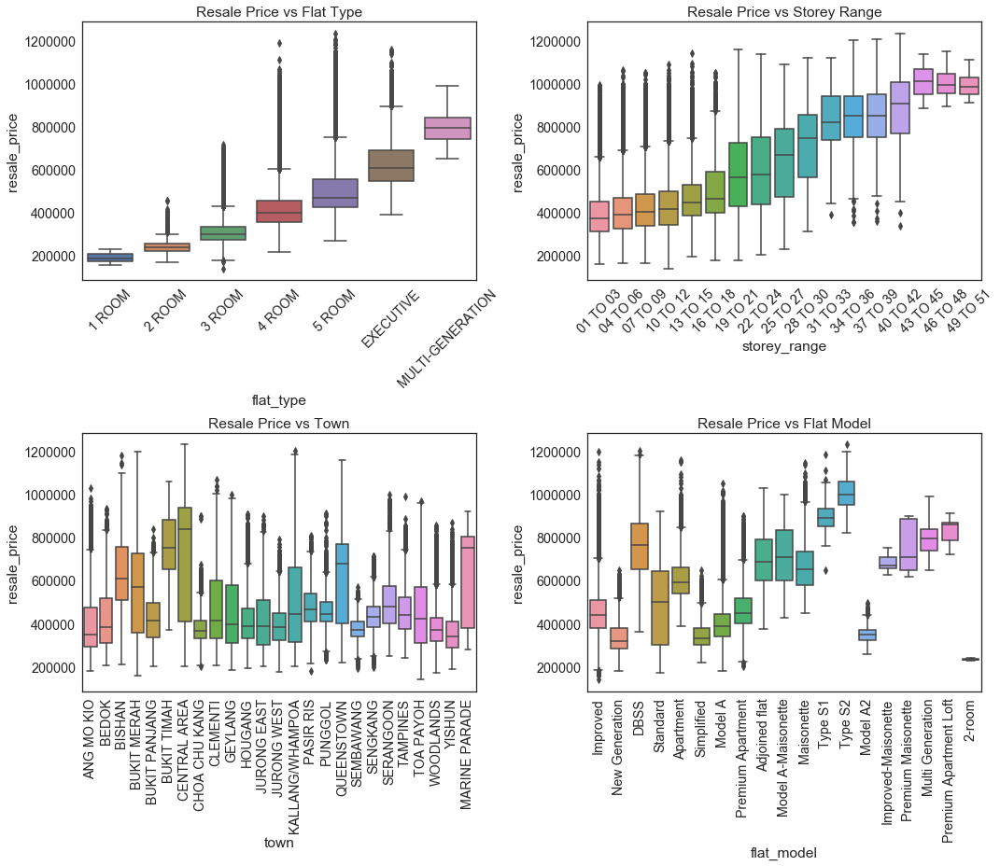

In [51]:
fig=plt.figure(figsize=(15, 13))
plt.subplot(221)
plt.title("Resale Price vs Flat Type")
plt.xticks(rotation=45)
sns.boxplot(x='flat_type', y='resale_price', order=sorted(hdb_df['flat_type'].unique()), data=hdb_df)

plt.subplot(222)
plt.title("Resale Price vs Storey Range")
plt.xticks(rotation=45)
sns.boxplot(x='storey_range', y='resale_price', order=sorted(hdb_df['storey_range'].unique()), data=hdb_df)

plt.subplot(223)
plt.title("Resale Price vs Town")
plt.xticks(rotation=90)
sns.boxplot(x='town', y='resale_price', data=hdb_df)

plt.subplot(224)
plt.title("Resale Price vs Flat Model")
plt.xticks(rotation=90)
sns.boxplot(x='flat_model', y='resale_price', data=hdb_df)

fig.tight_layout();

With the resale prices plotted out on box plots with categorical features, we can observe that the type of flats and how high up they are (storey range) have a positive correlation with resale prices. This shows that the size of a flat and its height affects its resale value.

The location of the resale flat in each town also may contribute to higher resale prices as flats closer to the city centre such as in towns like Bukit Merah, Central Area, Kallang/Whampoa, Queenstown and Marine Parade have higher median resale prices as compared to the rest. Bishan and Bukit Merah also have higher resale prices due to their higher perceived value.

# Unsupervised Learning (PCA, GMM & K-Means Clustering)

The main goal of this project is to pick out important features and building a regression model for the prediction of resale flat prices in Singapore. Unsupervised learning will be conducted on the dataset first to discover any hidden relationships or important features that influence other features within the data. Similar features identified from PCA and clustering can be picked out as having more impact on the resale prices of flats. The results from clustering can also be added as additional categorical features into the dataset to aid with the prediction of resale prices.

First, the features we are interested in are kept and the rest are dropped due to repetition. String features like address and location are not needed as the latitude and longitude coordinates are already included. Lease commence date is the same as remaining lease and is dropped as well.

In [52]:
drop_list = ['month', 'block', 'street_name', 'lease_commence_date', 'address', 'location', 'geometry', 'height', 'resale_price']
X = hdb_df.drop(drop_list, axis=1)
y = hdb_df.resale_price
X.head()

,town,flat_type,storey_range,floor_area_sqm,flat_model,remaining_lease,Latitude,Longitude,dist_to_expressway,dist_to_mrt,dist_to_mall,dist_to_cbd
0,ANG MO KIO,2 ROOM,10 TO 12,44.000,Improved,61,1.369,103.857,0.003,0.007,0.008,0.085
1,ANG MO KIO,3 ROOM,01 TO 03,67.000,New Generation,60,1.370,103.837,0.023,0.013,0.012,0.087
2,ANG MO KIO,3 ROOM,01 TO 03,67.000,New Generation,62,1.380,103.836,0.013,0.009,0.017,0.097
3,ANG MO KIO,3 ROOM,04 TO 06,68.000,New Generation,62,1.366,103.857,0.003,0.009,0.009,0.082
4,ANG MO KIO,3 ROOM,01 TO 03,67.000,New Generation,62,1.377,103.838,0.017,0.008,0.013,0.094


The categorical values in town, flat type, storey range and flat model are one-hot encoded.

In [53]:
X_ohe = pd.get_dummies(X)
X_ohe.head()

,floor_area_sqm,remaining_lease,Latitude,Longitude,dist_to_expressway,dist_to_mrt,dist_to_mall,dist_to_cbd,town_ANG MO KIO,town_BEDOK,...,flat_model_Model A2,flat_model_Multi Generation,flat_model_New Generation,flat_model_Premium Apartment,flat_model_Premium Apartment Loft,flat_model_Premium Maisonette,flat_model_Simplified,flat_model_Standard,flat_model_Type S1,flat_model_Type S2
0,44.000,61,1.369,103.857,0.003,0.007,0.008,0.085,1,0,...,0,0,0,0,0,0,0,0,0,0
1,67.000,60,1.370,103.837,0.023,0.013,0.012,0.087,1,0,...,0,0,1,0,0,0,0,0,0,0
2,67.000,62,1.380,103.836,0.013,0.009,0.017,0.097,1,0,...,0,0,1,0,0,0,0,0,0,0
3,68.000,62,1.366,103.857,0.003,0.009,0.009,0.082,1,0,...,0,0,1,0,0,0,0,0,0,0
4,67.000,62,1.377,103.838,0.017,0.008,0.013,0.094,1,0,...,0,0,1,0,0,0,0,0,0,0


The features are scaled down to a similar scale of between 0 and 1 with `StandardScaler()`. Normalisation is done to prevent features with larger values from dominating the variances for PCA. Normalisation is also important for distance-based algorithims, such as SVM and k-nearest neighbours, to prevent features with wide ranges from dominating the distance metric. Standardisation is also useful when the data has varying scales and the algorithm we are using does make assumptions about your data having a Gaussian distribution.

(https://www.analyticsvidhya.com/blog/2020/04/feature-scaling-machine-learning-normalization-standardization/)

In [54]:
scaler = StandardScaler()
scaler.fit(X_ohe)
X_ohe_tf = scaler.transform(X_ohe)

Using PCA on the first two principal components, we can visualise the dataset on a 2D plot to see if any distinct clusters are apparent.

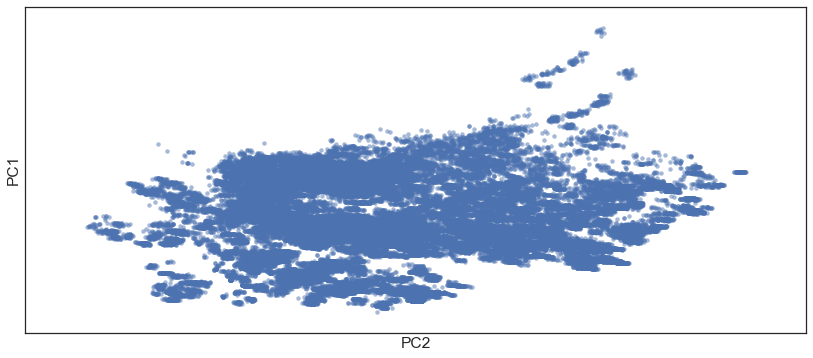

In [55]:
# Fit only top two principal components
pca = PCA(n_components=2)
X_train_2d = pca.fit_transform(X_ohe_tf)

h = .02  # step size in the mesh

# Create a mesh to plot in
x_min, x_max = X_train_2d[:, 0].min() - 1, X_train_2d[:, 0].max() + 1
y_min, y_max = X_train_2d[:, 1].min() - 1, X_train_2d[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

plt.figure(figsize=(14, 6))

# Plot also the training points
ax = sns.scatterplot(X_train_2d[:, 0], X_train_2d[:, 1], marker="o", palette="Set1", s=20, linewidth=0, alpha=0.5)
plt.xlabel('PC2')
plt.ylabel('PC1')
plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.xticks(())
plt.yticks(())
#ax.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left', fontsize=15);

plt.show()

From the plotted principal components, there seems to be no obvious clusters in the dataset. However, that might not be the case because there may be hidden relationships in the higher dimensions. We can further break down the features making up each principal components by plotting the variances for each feature on each principal component axis to uncover hidden relationships within the data.

In [56]:
# Fit all principal components
pca = PCA()
pca.fit(X_ohe_tf)

PCA()

The eigenvalues (explained variance) falls off drastically after the first component, which indicates that the first component consists of features that dominates the rest of the principal components. It further falls off from the 6<sup>th</sup> component onwards and remains relatively stable before falling off from the 58<sup>th</sup> component onwards.

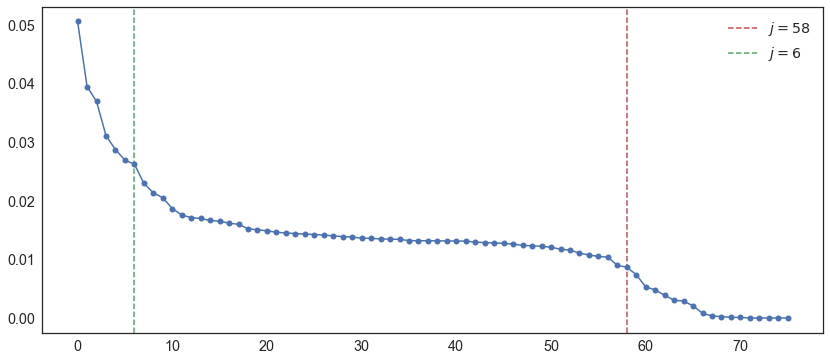

In [57]:
plt.figure(figsize=(14, 6))
plt.axvline(x=58, c='r', ls='--', label=r'$j=58$')
plt.axvline(x=6, c='g', ls='--', label=r'$j=6$')
plt.plot(pca.explained_variance_ratio_, '-o')
plt.legend();

Visualising the top three principal components, we can see what features dominate each principal component:

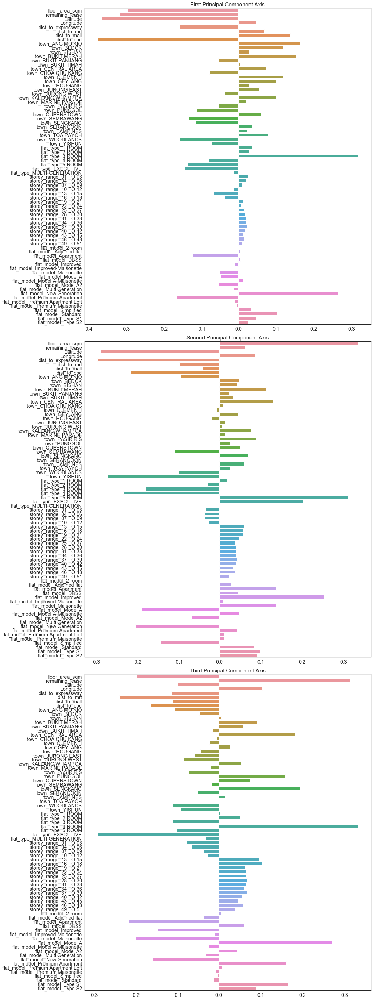

In [58]:
fig, ax = plt.subplots(3, 1, figsize=(15, 40))
sns.barplot(x=pca.components_[0], y=X_ohe.columns, orient='h', ax=ax[0])
sns.barplot(x=pca.components_[1], y=X_ohe.columns, orient='h', ax=ax[1])
sns.barplot(x=pca.components_[2], y=X_ohe.columns, orient='h', ax=ax[2])

ax[0].set_title('First Principal Component Axis')
ax[1].set_title('Second Principal Component Axis')
ax[2].set_title('Third Principal Component Axis')
fig.tight_layout()

For the first axis, distance to CBD, new generation 3-room flats, floor area and remaining lease makes up a big part of this component. The second axis is made up of mostly improved 4-room, 5-room and executive flats and the floor area, while the third axis is made up of distance to expressway and MRT, latitude, executive flats and flats in Yishun and the Central area.

Using PCA can help us with selecting the most important features for predicting resale prices. For this dataset, distance to CBD, floor area and remaining lease have high variances in all three principal components.

#### Recommender System with PCA

The features picked out by each principal component can also be used to make recommendation on similar resale flat choices based on a current input.

In [59]:
# Transform one-hot encoded features to latent space of important features.
latents = pca.transform(X_ohe)
latents = pd.DataFrame(
    data=latents,
    columns=[f'Latent dim {i+1}' for i in range(latents.shape[-1])],
)

Similar resale flats will have similar principal component scores. The distance in the latent space will serve as a measure of similarity, allowing similar flats to be found for a given choice of flat.

We will take the first 6 principal components to calculate the score, based on the variance plot earlier since the top 6 components have the most prominent features for recommendation.

In [60]:
scores = latents.to_numpy()[:, :6] # Compute PC scores using only first 6 components

In [61]:
selected_flat = 36495 # Select a flat to base our recommendation on

In [62]:
distances = np.sum((scores - scores[selected_flat, np.newaxis, :])**2, axis=1) # Compute L^2 distances to the input Score

In [63]:
rec_ids = np.argsort(distances)[1:1+10] # Return recommendations based on closest products in PCA latent space
rec_ids

array([36495, 44084, 25876, 28989, 24138, 24141, 25885, 30465, 39532,
       24119], dtype=int64)

In [64]:
hdb_df.iloc[selected_flat] # Details of selected flat

month                                                            2019-04
town                                                             PUNGGOL
flat_type                                                         4 ROOM
block                                                               209B
street_name                                                   PUNGGOL PL
storey_range                                                    07 TO 09
floor_area_sqm                                                    92.000
flat_model                                                       Model A
lease_commence_date                                                 2014
remaining_lease                                                       94
resale_price                                                  470000.000
address                                                  209B PUNGGOL PL
height                                                          Mid-High
location               Punggol Crest, 209B, Punggol

As seen below, the recommended flats have a similar nature to the selected flat used for recommendation. For any given input, we will recommend some closest neighbour to this in the PCA latent space, which gives similar resale flats that potential buyers might want to consider as well. 

In [65]:
# Details of recommended similar flats
hdb_df.iloc[rec_ids][['month', 'block', 'town', 'street_name', 'storey_range', 'height', 'flat_type', 'flat_model', 'floor_area_sqm', 'remaining_lease', 'resale_price']]

,month,block,town,street_name,storey_range,height,flat_type,flat_model,floor_area_sqm,remaining_lease,resale_price
36495,2019-04,209B,PUNGGOL,PUNGGOL PL,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,470000.000
44084,2019-09,209B,PUNGGOL,PUNGGOL PL,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,433000.000
25876,2018-08,208C,PUNGGOL,PUNGGOL PL,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,450000.000
28989,2018-10,211C,PUNGGOL,PUNGGOL WALK,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,408000.000
24138,2018-07,211B,PUNGGOL,PUNGGOL WALK,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,460000.000
24141,2018-07,211B,PUNGGOL,PUNGGOL WALK,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,480000.000
25885,2018-08,211B,PUNGGOL,PUNGGOL WALK,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,465000.000
30465,2018-11,211A,PUNGGOL,PUNGGOL WALK,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,468000.000
39532,2019-06,207D,PUNGGOL,PUNGGOL PL,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,495000.000
24119,2018-07,208B,PUNGGOL,PUNGGOL PL,07 TO 09,Mid-High,4 ROOM,Model A,92.000,94,440000.000


### Clustering with GMM and K-Means

We can perform clustering with both GMM and K-Means to discover any interesting relationship or features that can be used to predict resale prices. The results from clustering can also be compared with that of PCA to see if they agree with each other. Clustering is first done with all the features we selected in the transformed one-hot-encoded dataset `X_ohe_tf` without resale prices.

#### Gaussian Mixture Models

A Gaussian Mixture is a function that is comprised of several Gaussians, each identified by k ∈ {1,…, K}, where K is the number of clusters of our dataset. Each Gaussian k in the mixture is comprised of the following parameters:
* A mean μ that defines its centre.
* A covariance Σ that defines its width. This would be equivalent to the dimensions of an ellipsoid in a multivariate scenario.
* A mixing probability π that defines how big or small the Gaussian function will be.

Using GMM, we can can derive insights from the data via the clusters within.

In [66]:
def SelBest(arr:list, X:int)->list:
    '''
    returns the set of X configurations with shorter distance
    '''
    dx=np.argsort(arr)[:X]
    return arr[dx]

In [67]:
embeddings = X_ohe_tf[np.random.choice(X_ohe_tf.shape[0], 1000, replace=False), :] # Take 1000 random samples
n_clusters=np.arange(2, 20)
sils=[]
sils_err=[]
iterations=10
for n in tqdm(n_clusters):
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GMM(n, n_init=2).fit(embeddings) 
        labels=gmm.predict(embeddings)
        sil=silhouette_score(embeddings, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

100%|██████████████████████████████████████████████████████████████| 18/18 [00:35<00:00,  2.00s/it]


The silhouette score considers the following:
* The mean distance between a sample and all other points in the same cluster.
* The mean distance between a sample and all other points in the next nearest cluster.

It checks how much the clusters are compact and well separated. The more the score is near to one, the better the clustering is. From the below, it doesn't look like we can find a suitable number of clusters with this method, as the score keeps increasing for the number of clusters tested.

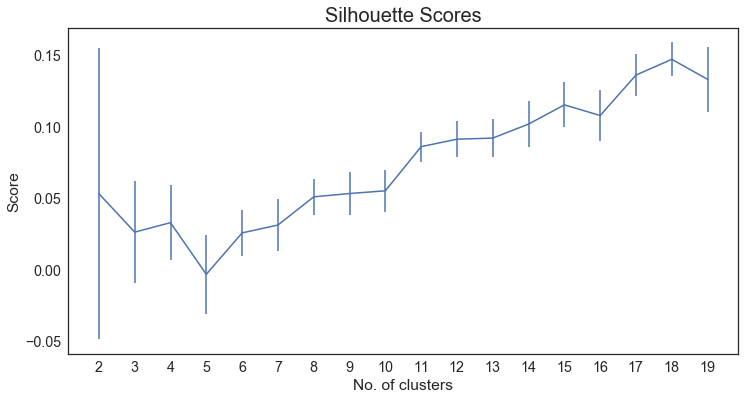

In [68]:
plt.figure(figsize=(12,6))
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("Silhouette Scores", fontsize=20)
plt.xticks(n_clusters)
plt.xlabel("No. of clusters")
plt.ylabel("Score");

The BIC criterion gives us an estimation on how much is good the GMM in terms of predicting the data we actually have. The lower is the BIC, the better is the model to actually predict the data we have, and by extension, the true, unknown, distribution. In order to avoid overfitting, this technique penalizes models with big number of clusters.

In [69]:
bics=[]
bics_err=[]
iterations=20
for n in tqdm(n_clusters):
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GMM(n, n_init=2).fit(embeddings) 
        tmp_bic.append(gmm.bic(embeddings))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

100%|██████████████████████████████████████████████████████████████| 18/18 [01:09<00:00,  3.85s/it]


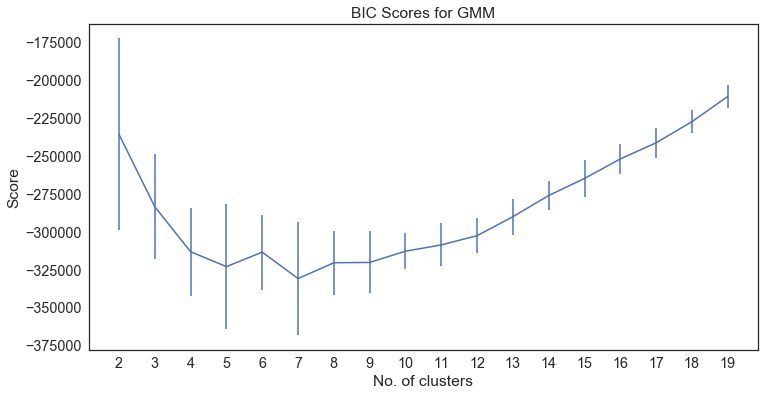

In [70]:
plt.figure(figsize=(12,6))
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("BIC Scores for GMM")
plt.xticks(n_clusters)
plt.xlabel("No. of clusters")
plt.ylabel("Score");

Starting from a cluster size of 5 the gradient become almost constant, i.e. the original function has a more gentle decrease and there is not much gain in increasing the number of clusters. 

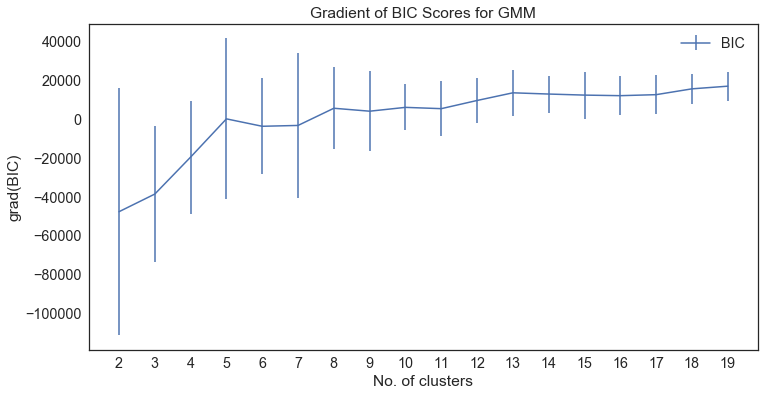

In [71]:
plt.figure(figsize=(12,6))
plt.errorbar(n_clusters, np.gradient(bics), yerr=bics_err, label='BIC')
plt.title("Gradient of BIC Scores for GMM")
plt.xticks(n_clusters)
plt.xlabel("No. of clusters")
plt.ylabel("grad(BIC)")
plt.legend();

Picking a cluster size of 5 results in intermixing with other clusters. This could mean that GMM may not be a good method for clustering the data, or that the other clusters are hidden from view due to them being in the higher dimension.

In [72]:
gmm = GMM(n_components=5, random_state=42).fit(X_ohe_tf)
labels = gmm.predict(X_ohe_tf)

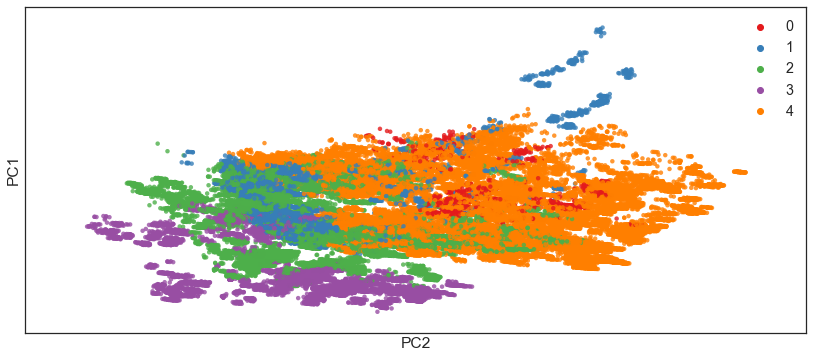

In [73]:
plt.figure(figsize=(14, 6))
plt.xlabel('PC2')
plt.ylabel('PC1')
plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.xticks(())
plt.yticks(())
sns.scatterplot(X_train_2d[:, 0], X_train_2d[:, 1], marker="o", hue=labels, palette="Set1", s=20, linewidth=0, alpha=0.8);

#### K-Means Clustering

While GMM can be seen as a 'soft' version of K-means clustering, K-means only iteratively updates the centre and assignments without updating the mean and covariance of the distributions. 

In [74]:
# fitting multiple k-means algorithms and storing the values in an empty list
SSE = []
for cluster in tqdm(range(1,20)):
    kmeans = KMeans(n_jobs = -1, n_clusters = cluster, init='k-means++')
    kmeans.fit(embeddings)
    SSE.append(kmeans.inertia_)

100%|██████████████████████████████████████████████████████████████| 19/19 [00:01<00:00, 13.60it/s]


The elbow method calculates the Within-Cluster-Sum of Squared Errors (WSS) for different values of k, and choose the k for which WSS becomes first starts to diminish. In the plot of WSS-versus-k, this is visible as an elbow. Using the elbow method, however, is difficult to tell what is the optimum number of clusters to use in our case. 

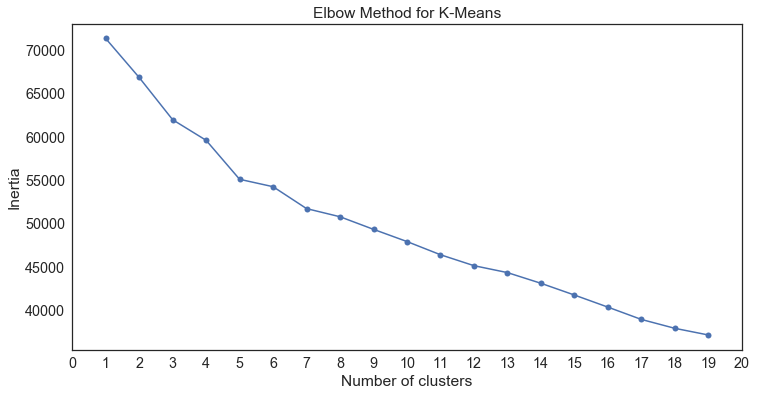

In [75]:
# converting the results into a dataframe and plotting them
frame = pd.DataFrame({'Cluster':range(1,20), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(frame['Cluster'], frame['SSE'], marker='o')
plt.xticks(np.arange(0, 21, 1))
plt.title('Elbow Method for K-Means')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia');

We can use the silhouette method as defined before to get the best number of clusters. In this case, the best number of clusters would be 2 as it has the highest score and is closest to 1.

In [76]:
sil = []
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for cluster in tqdm(range(2, 20)):
    kmeans = KMeans(n_jobs = -1, n_clusters = cluster, init='k-means++').fit(embeddings)
    labels = kmeans.labels_
    sil.append(silhouette_score(embeddings, labels, metric = 'euclidean'))

100%|██████████████████████████████████████████████████████████████| 18/18 [00:01<00:00, 12.45it/s]


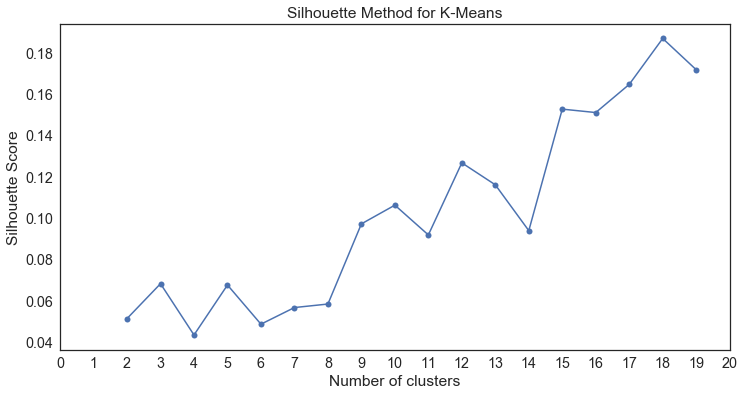

In [77]:
# converting the results into a dataframe and plotting them
frame = pd.DataFrame({'Cluster':range(1,20), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(range(2, 20), sil, marker='o')
plt.xticks(np.arange(0, 21, 1))
plt.title('Silhouette Method for K-Means')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score');

Plotting the clusters in the PCA plot shows a clear and distinct separation between the two clusters, which can be intuitively understood.

In [78]:
kmeans = KMeans(n_clusters=2, random_state=42, init='k-means++')
kmeans.fit(X_ohe_tf)
labels = kmeans.predict(X_ohe_tf)

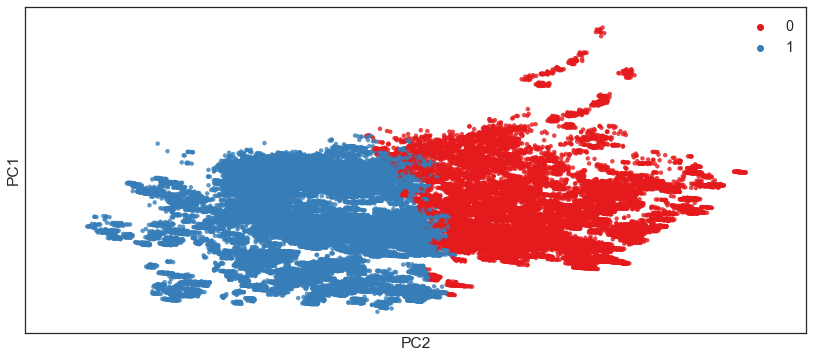

In [79]:
plt.figure(figsize=(14, 6))
plt.xlabel('PC2')
plt.ylabel('PC1')
plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.xticks(())
plt.yticks(())
sns.scatterplot(X_train_2d[:, 0], X_train_2d[:, 1], marker="o", hue=labels, palette="Set1", s=20, linewidth=0, alpha=0.8);

With K-Means Clustering, two distinct clusters are picked out from both principal components. This is further shown in the 3D PCA plot below.

In [80]:
pca3d = PCA(n_components=3)
components = pca3d.fit_transform(X_ohe_tf)

total_var = pca3d.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=labels,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

By adding the cluster labels to the dataset, we can visualise the differences of both clusters that K-means has picked.

In [81]:
hdb_df['kmeans_all_feats'] = labels

It looks like clustering has split our datasets into two broad groups of data based on their distance to CBD, floor area and flat type:
* Smaller units nearer to CBD are clustered into Cluster 0 with 4-room and 3-room flats mostly (red points).
* Bigger units (>100 sqm) further away from CBD are clustered into Cluster 1 with 5-room and Executive flats dominating (blue points). 

This also agrees with the top two principal components picked out via PCA, where the first axis is dominated by new generation smaller 3-room flats, floor area and distance to CBD, while the second axis is dominated by bigger 5-room and executive flats and floor area. Through unsupervised learning with both K-Means and PCA, the dataset is mostly clustered by distance to CBD and flat sizes through floor area and these features has the most variance out of all the features due to its large impact on the top few principal components. Accordingly, resale prices and floor area share the highest correlation (0.64) as compared to all the other features as well.

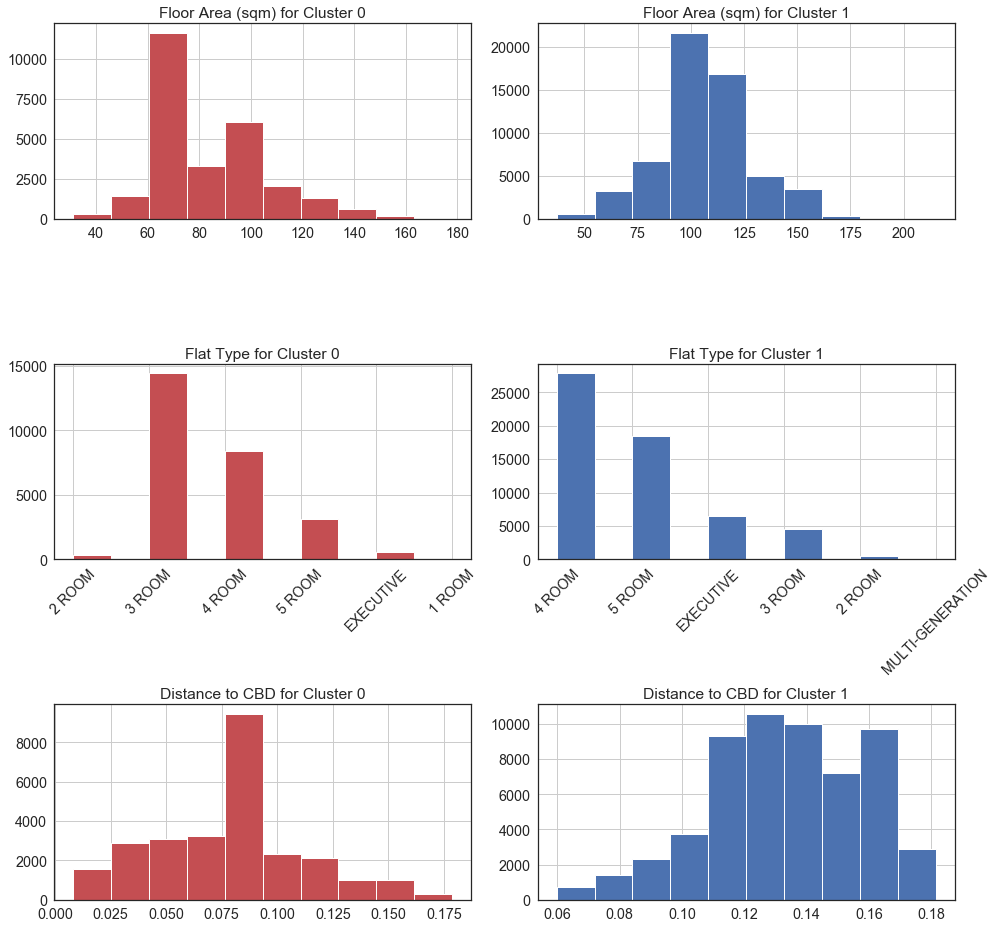

In [82]:
fig=plt.figure(figsize=(14, 13))
plt.subplot(321)
plt.title("Floor Area (sqm) for Cluster 0")
hdb_df[hdb_df.kmeans_all_feats == 0].floor_area_sqm.hist(color='r')

plt.subplot(323)
plt.title("Flat Type for Cluster 0")
plt.xticks(rotation=45)
hdb_df[hdb_df.kmeans_all_feats == 0].flat_type.hist(color='r')

plt.subplot(325)
plt.title("Distance to CBD for Cluster 0")
hdb_df[hdb_df.kmeans_all_feats == 0].dist_to_cbd.hist(color='r')

plt.subplot(322)
plt.title("Floor Area (sqm) for Cluster 1")
hdb_df[hdb_df.kmeans_all_feats == 1].floor_area_sqm.hist(color='b')

plt.subplot(324)
plt.title("Flat Type for Cluster 1")
plt.xticks(rotation=45)
hdb_df[hdb_df.kmeans_all_feats == 1].flat_type.hist(color='b')

plt.subplot(326)
plt.title("Distance to CBD for Cluster 1")
hdb_df[hdb_df.kmeans_all_feats == 1].dist_to_cbd.hist(color='b')

fig.tight_layout();

By plotting out the locations of both clusters on a map, we can visualise the general distribution of both clusters and their locations in Singapore:

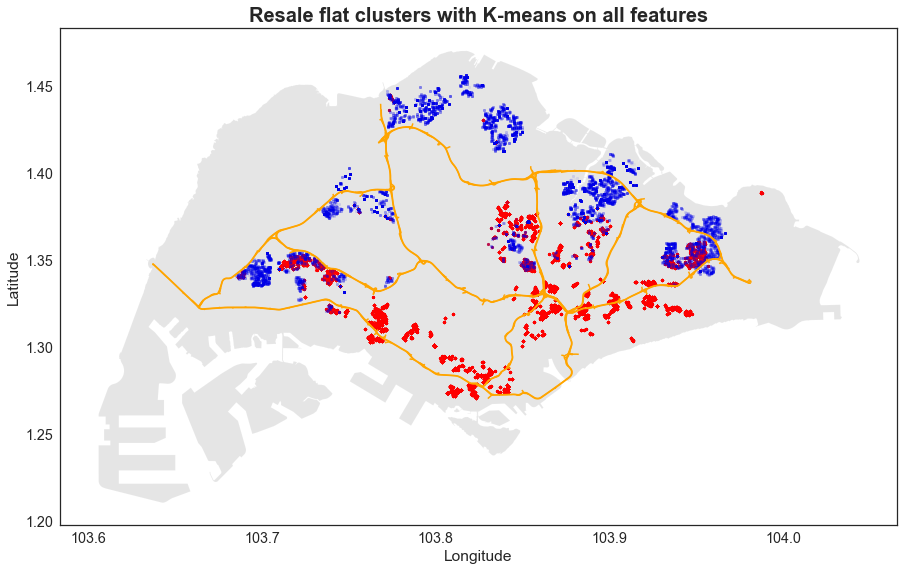

In [83]:
fig, ax = plt.subplots(figsize=(15,10))
plt.title('Resale flat clusters with K-means on all features', fontweight="bold", fontsize=20)
#ele_df.plot(color='black', alpha=0.6, ax=ax)
exp_df.plot(color='orange', ax=ax)
#mrt_df.plot(color='darkblue', markersize=10, ax=ax)
#mall_df.plot(color='red', markersize=5, ax=ax)
sgp_df.plot(color='black', alpha=0.1, ax=ax)
sns.scatterplot(hdb_df[hdb_df.kmeans_all_feats == 0]['Longitude'], hdb_df[hdb_df.kmeans_all_feats == 0]['Latitude'], marker="o", color="red", s=10, linewidth=0, alpha=0.9)
sns.scatterplot(hdb_df[hdb_df.kmeans_all_feats == 1]['Longitude'], hdb_df[hdb_df.kmeans_all_feats == 1]['Latitude'], marker="o", color="blue", s=10, linewidth=0, alpha=0.04);

It looks like the two distinct clusters are split up along the middle of the map with generally smaller flats being closer to the CBD (red) and larger flats being further away from the CBD (blue).

#### GMM and KMeans on Longitude and Latitude

Since our dataset contains location data, we can try both GMM and K-means to find interesting clusters within their placement on the map. For this part, only the location features `latitude` and `longitude` will be used for clustering.

The below visualisation shows the placement of resale flats according to their map coordinates, and their placement suggests that there may be distinct clusters according to location data.

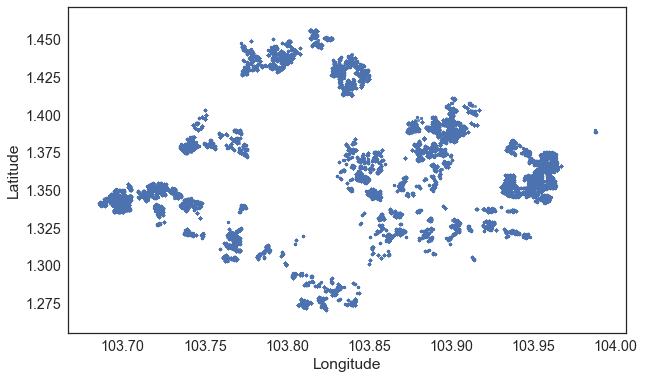

In [84]:
plt.figure(figsize=(10, 6))
sns.scatterplot(hdb_df['Longitude'], hdb_df['Latitude'], marker="o", palette="Set1", s=10, linewidth=0, alpha=0.8);

The below does the same as previously defined to find the optimal number of clusters for both GMM and K-means.

In [85]:
# fitting multiple k-means algorithms and storing the values in an empty list
hdb_locs = hdb_df[['Latitude', 'Longitude']].sample(n=1000, random_state=42) # Take 1000 random samples
SSE = []
for cluster in tqdm(range(1,20)):
    kmeans = KMeans(n_jobs = -1, n_clusters = cluster, init='k-means++')
    kmeans.fit(hdb_locs)
    SSE.append(kmeans.inertia_)

100%|██████████████████████████████████████████████████████████████| 19/19 [00:01<00:00, 13.25it/s]


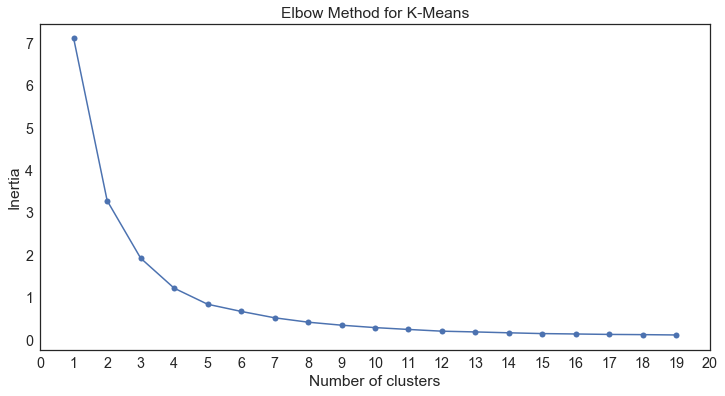

In [86]:
# converting the results into a dataframe and plotting them
frame = pd.DataFrame({'Cluster':range(1,20), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(frame['Cluster'], frame['SSE'], marker='o')
plt.xticks(np.arange(0, 21, 1))
plt.title('Elbow Method for K-Means')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia');

The elbow method does not give a good indication on the ideal number of clusters, so we will use the silhouette score.

In [87]:
sil = []
# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for cluster in tqdm(range(2, 20)):
    kmeans = KMeans(n_jobs = -1, n_clusters = cluster, init='k-means++').fit(hdb_locs)
    labels = kmeans.labels_
    sil.append(silhouette_score(hdb_locs, labels, metric = 'euclidean'))

100%|██████████████████████████████████████████████████████████████| 18/18 [00:01<00:00, 14.73it/s]


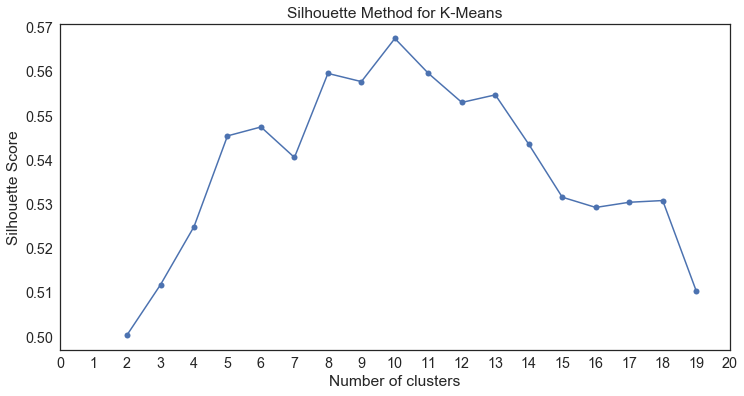

In [88]:
# converting the results into a dataframe and plotting them
frame = pd.DataFrame({'Cluster':range(1,20), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(range(2, 20), sil, marker='o')
plt.xticks(np.arange(0, 21, 1))
plt.title('Silhouette Method for K-Means')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score');

Number of clusters for K-means is picked to be 10 using the silhouette method, since 10 clusters scored the highest.

In [89]:
bics=[]
bics_err=[]
iterations=20
for n in tqdm(n_clusters):
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GMM(n, n_init=2).fit(hdb_locs) 
        tmp_bic.append(gmm.bic(hdb_locs))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

100%|██████████████████████████████████████████████████████████████| 18/18 [00:17<00:00,  1.01it/s]


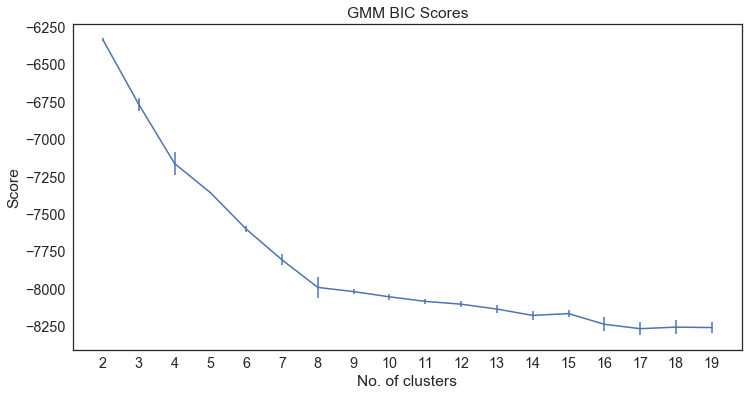

In [90]:
plt.figure(figsize=(12,6))
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("GMM BIC Scores")
plt.xticks(n_clusters)
plt.xlabel("No. of clusters")
plt.ylabel("Score");

In [91]:
n_clusters=np.arange(2, 20)
sils=[]
sils_err=[]
iterations=10
for n in tqdm(n_clusters):
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GMM(n, n_init=2).fit(hdb_locs) 
        labels=gmm.predict(hdb_locs)
        sil=silhouette_score(hdb_locs, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

100%|██████████████████████████████████████████████████████████████| 18/18 [00:11<00:00,  1.58it/s]


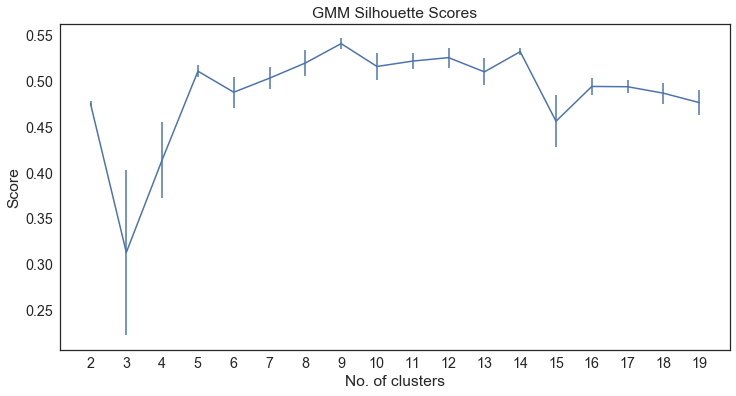

In [92]:
plt.figure(figsize=(12,6))
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("GMM Silhouette Scores")
plt.xticks(n_clusters)
plt.xlabel("No. of clusters")
plt.ylabel("Score");

Number of clusters for GMM is picked to be 9 from silhouette score.

In [93]:
# Plug both optimal number of clusters into both algorithms for visualisation.
kmeans = KMeans(n_clusters=10, init='k-means++', random_state=42)
kmeans.fit(hdb_df[['Latitude', 'Longitude']])
labels_k = kmeans.predict(hdb_df[['Latitude', 'Longitude']])

gmm = GMM(n_components=9, random_state=42)
gmm.fit(hdb_df[['Latitude', 'Longitude']])
labels_g = gmm.predict(hdb_df[['Latitude', 'Longitude']])

Plotting the clusters created by GMM and K-means, we can see that they roughly fall into the different districts/constituencies of Singapore.

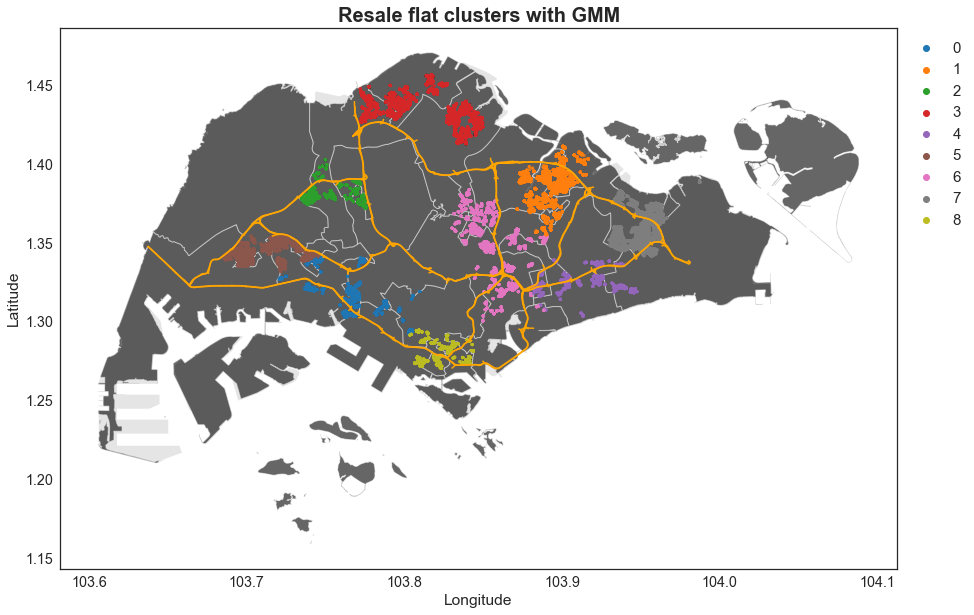

In [94]:
fig, ax = plt.subplots(figsize=(15,10))
plt.title('Resale flat clusters with GMM', fontweight="bold", fontsize=20)
ele_df.plot(color='black', alpha=0.6, ax=ax)
exp_df.plot(color='orange', ax=ax)
#mrt_df.plot(color='darkblue', markersize=10, ax=ax)
#mall_df.plot(color='red', markersize=5, ax=ax)
sgp_df.plot(color='black', alpha=0.1, ax=ax)
sns.scatterplot(hdb_df['Longitude'], hdb_df['Latitude'], marker="o", hue=labels_g, palette="tab10", s=10, linewidth=0, alpha=0.8)
ax.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left', fontsize=15);

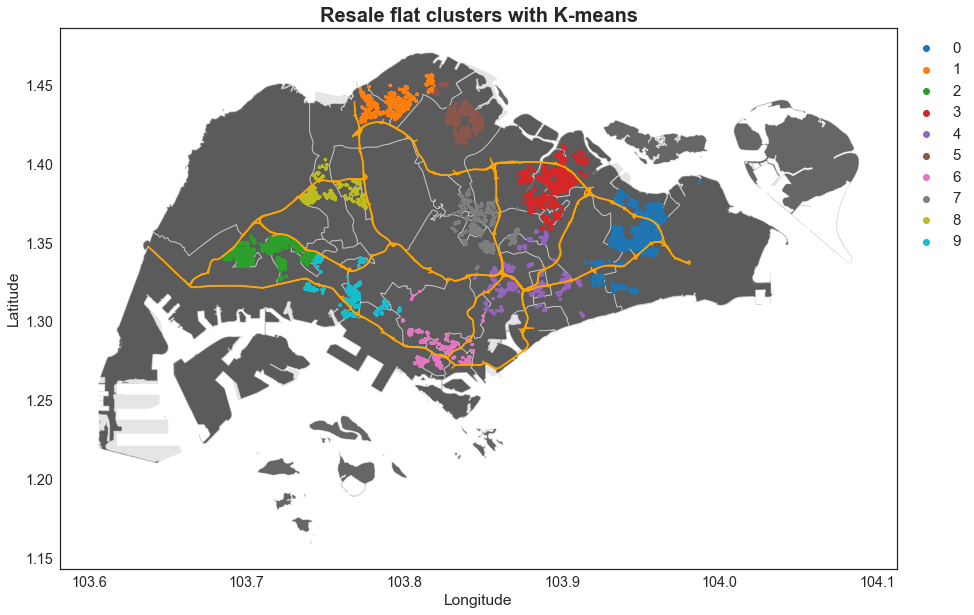

In [95]:
fig, ax = plt.subplots(figsize=(15,10))
plt.title('Resale flat clusters with K-means', fontweight="bold", fontsize=20)
ele_df.plot(color='black', alpha=0.6, ax=ax)
exp_df.plot(color='orange', ax=ax)
#mrt_df.plot(color='darkblue', markersize=10, ax=ax)
#mall_df.plot(color='red', markersize=5, ax=ax)
sgp_df.plot(color='black', alpha=0.1, ax=ax)
sns.scatterplot(hdb_df['Longitude'], hdb_df['Latitude'], marker="o", hue=labels_k, palette="tab10", s=10, linewidth=0, alpha=0.8)
ax.legend(bbox_to_anchor=(1.0, 1.0), loc='upper left', fontsize=15);

We will take the clustering by K-means for further visualisation.

In [96]:
hdb_df['kmeans_locs'] = labels_k

In [97]:
# Visualise the towns corresponding to each cluster
for i in range(hdb_df.kmeans_locs.nunique()):
    print('Cluster '+str(i)+' :'+str(hdb_df[hdb_df.kmeans_locs == i].town.unique()))

Cluster 0 :['BEDOK' 'PASIR RIS' 'TAMPINES']
Cluster 1 :['SEMBAWANG' 'WOODLANDS']
Cluster 2 :['JURONG EAST' 'JURONG WEST']
Cluster 3 :['HOUGANG' 'PUNGGOL' 'SENGKANG' 'SERANGOON']
Cluster 4 :['BEDOK' 'GEYLANG' 'HOUGANG' 'KALLANG/WHAMPOA' 'SERANGOON' 'TOA PAYOH'
 'CENTRAL AREA' 'MARINE PARADE']
Cluster 5 :['SEMBAWANG' 'YISHUN']
Cluster 6 :['BUKIT MERAH' 'BUKIT TIMAH' 'CENTRAL AREA' 'QUEENSTOWN']
Cluster 7 :['ANG MO KIO' 'BISHAN' 'SERANGOON' 'TOA PAYOH']
Cluster 8 :['BUKIT PANJANG' 'CHOA CHU KANG']
Cluster 9 :['BUKIT TIMAH' 'CLEMENTI' 'JURONG EAST' 'QUEENSTOWN']


Cluster 3 `'HOUGANG' 'PUNGGOL' 'SENGKANG' 'SERANGOON'` contains the most number of resale flats, followed by cluster 0 `'BEDOK' 'PASIR RIS' 'TAMPINES'`. This makes sense as the estates in those areas are mature and these places are mainly populated by HDB flats both old and new.

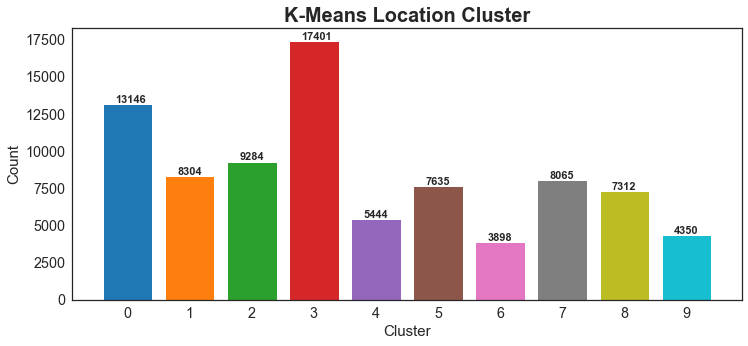

In [98]:
fig, ax = plt.subplots(figsize=(12, 5))
ax.bar(hdb_df.kmeans_locs.value_counts().sort_index().index, hdb_df.kmeans_locs.value_counts().sort_index().values, color=sns.color_palette("tab10"))
plt.title('K-Means Location Cluster', fontsize=20, fontweight='bold') 
plt.xlabel('Cluster', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.xticks(np.arange(0, 10, 1))
for i, v in enumerate(hdb_df.kmeans_locs.value_counts().sort_index().values):
    ax.text(i-0.2, hdb_df.kmeans_locs.value_counts().sort_index().values[i]+100, "%.f" % v, fontsize=11, fontweight='bold');

Visualising the resale prices for each cluster, it is found that Cluster 6 `'BUKIT MERAH' 'BUKIT TIMAH' 'CENTRAL AREA' 'QUEENSTOWN'` has some of the highest median resale flat prices at S$630,000. This makes sense as the estates around those areas are on prime land and are located very near the city central. There may be a trend with distance from the city affecting the resale value of a flat.

In [99]:
for i in range(hdb_df.kmeans_locs.nunique()):
    print('Cluster '+str(i)+' Median Resale Prices: '+str(hdb_df[hdb_df.kmeans_locs == i].resale_price.median()))

Cluster 0 Median Resale Prices: 437000.0
Cluster 1 Median Resale Prices: 370000.0
Cluster 2 Median Resale Prices: 382000.0
Cluster 3 Median Resale Prices: 430000.0
Cluster 4 Median Resale Prices: 412000.0
Cluster 5 Median Resale Prices: 345000.0
Cluster 6 Median Resale Prices: 630000.0
Cluster 7 Median Resale Prices: 430000.0
Cluster 8 Median Resale Prices: 380000.0
Cluster 9 Median Resale Prices: 450000.0


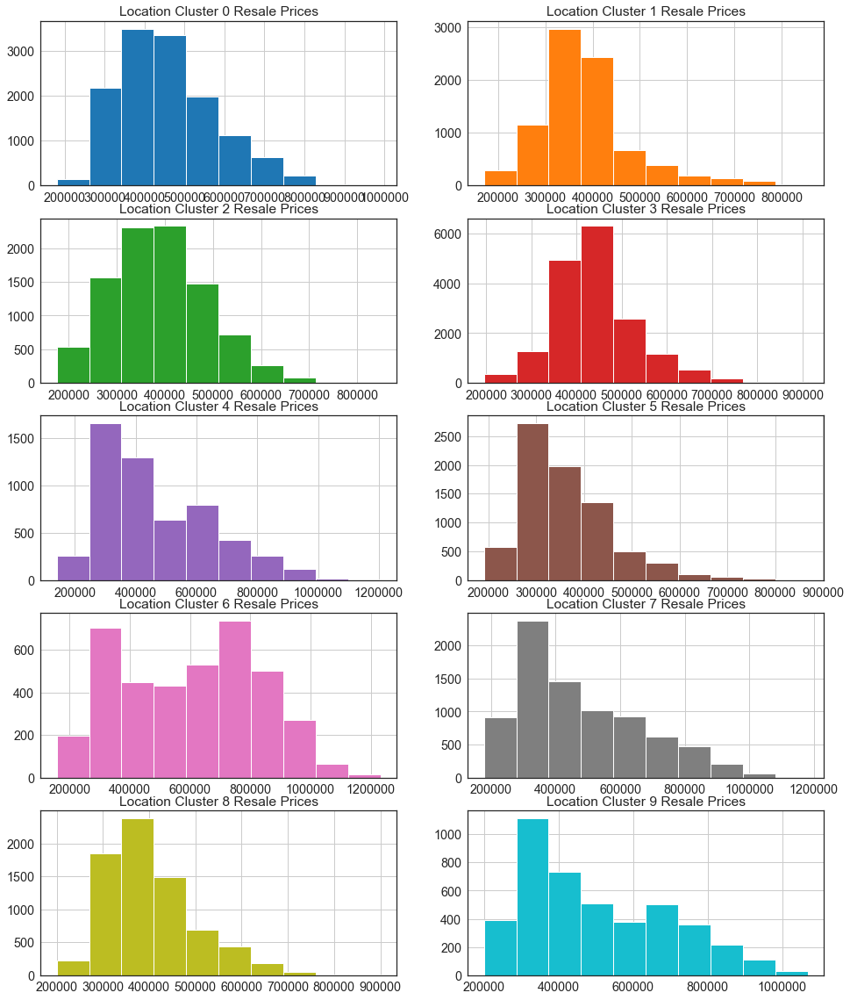

In [100]:
fig, ax = plt.subplots(5, 2, figsize=(16, 20))
ax = ax.flatten()
    
for i in range(hdb_df.kmeans_locs.nunique()):
    hdb_df[hdb_df.kmeans_locs == i].resale_price.hist(ax = ax[i], color=sns.color_palette("tab10")[i])
    ax[i].set(title='Location Cluster '+str(i)+' Resale Prices');

# Supervised Learning

The clusters identified earlier using K-Means are added as additional features back into the dataset for supervised learning.

In [101]:
drop_list = ['month', 'block', 'street_name', 'lease_commence_date', 'address', 'location', 'geometry', 'height', 'resale_price']
X = hdb_df.drop(drop_list, axis=1)
y = hdb_df.resale_price
Xt_train, Xt_test, yt_train, yt_test = train_test_split(X, y, test_size = 0.5, random_state = 42) # No encoding train-test split
X.head()

,town,flat_type,storey_range,floor_area_sqm,flat_model,remaining_lease,Latitude,Longitude,dist_to_expressway,dist_to_mrt,dist_to_mall,dist_to_cbd,kmeans_all_feats,kmeans_locs
0,ANG MO KIO,2 ROOM,10 TO 12,44.000,Improved,61,1.369,103.857,0.003,0.007,0.008,0.085,0,7
1,ANG MO KIO,3 ROOM,01 TO 03,67.000,New Generation,60,1.370,103.837,0.023,0.013,0.012,0.087,0,7
2,ANG MO KIO,3 ROOM,01 TO 03,67.000,New Generation,62,1.380,103.836,0.013,0.009,0.017,0.097,0,7
3,ANG MO KIO,3 ROOM,04 TO 06,68.000,New Generation,62,1.366,103.857,0.003,0.009,0.009,0.082,0,7
4,ANG MO KIO,3 ROOM,01 TO 03,67.000,New Generation,62,1.377,103.838,0.017,0.008,0.013,0.094,0,7


The categorical values in town, flat type, storey range and flat model are one-hot encoded.

In [102]:
X_ohe = pd.get_dummies(X)
X_ohe.head()

,floor_area_sqm,remaining_lease,Latitude,Longitude,dist_to_expressway,dist_to_mrt,dist_to_mall,dist_to_cbd,kmeans_all_feats,kmeans_locs,...,flat_model_Model A2,flat_model_Multi Generation,flat_model_New Generation,flat_model_Premium Apartment,flat_model_Premium Apartment Loft,flat_model_Premium Maisonette,flat_model_Simplified,flat_model_Standard,flat_model_Type S1,flat_model_Type S2
0,44.000,61,1.369,103.857,0.003,0.007,0.008,0.085,0,7,...,0,0,0,0,0,0,0,0,0,0
1,67.000,60,1.370,103.837,0.023,0.013,0.012,0.087,0,7,...,0,0,1,0,0,0,0,0,0,0
2,67.000,62,1.380,103.836,0.013,0.009,0.017,0.097,0,7,...,0,0,1,0,0,0,0,0,0,0
3,68.000,62,1.366,103.857,0.003,0.009,0.009,0.082,0,7,...,0,0,1,0,0,0,0,0,0,0
4,67.000,62,1.377,103.838,0.017,0.008,0.013,0.094,0,7,...,0,0,1,0,0,0,0,0,0,0


#### Feature Selection using Recursive Feature Elimination (Random Forest)

Recursive Feature Elimination (RFE), is basically a backward elimination of the features. RFE first builds a model on the entire set of features and computes an importance score for each feature. The least important features or weights are then removed, and the model is rebuilt. The importance scores are recalculated, and this process goes on for each iteration until the R2-Score decreases.

We will fit a random forest classifier for this implementation of RFE and use a 10-fold cross validattion for each iteration to perform feature selection. Backward selection is usually used with random forests as they tend not to exclude variables from the prediction equation and has an internal method to rank feature importance. (https://bookdown.org/max/FES/recursive-feature-elimination.html)

In [103]:
# Change categorical features to categorical data type
for i in X.select_dtypes(include='object').columns:
    X[str(i)] = X[str(i)].astype('category')

X.kmeans_all_feats = X.kmeans_all_feats.astype('category')
X.kmeans_locs = X.kmeans_locs.astype('category')

In [104]:
# Simple numerical encoding for random forest
for i in X.select_dtypes(include='category'):
    X[str(i)] = X[str(i)].cat.codes

The categorical features in the dataset are numerically-encoded for feature selection as one-hot-encoding will cause them to get 'lost' within the feature selection.

In [105]:
X.head()

,town,flat_type,storey_range,floor_area_sqm,flat_model,remaining_lease,Latitude,Longitude,dist_to_expressway,dist_to_mrt,dist_to_mall,dist_to_cbd,kmeans_all_feats,kmeans_locs
0,0,1,3,44.000,4,61,1.369,103.857,0.003,0.007,0.008,0.085,0,7
1,0,2,0,67.000,11,60,1.370,103.837,0.023,0.013,0.012,0.087,0,7
2,0,2,0,67.000,11,62,1.380,103.836,0.013,0.009,0.017,0.097,0,7
3,0,2,1,68.000,11,62,1.366,103.857,0.003,0.009,0.009,0.082,0,7
4,0,2,0,67.000,11,62,1.377,103.838,0.017,0.008,0.013,0.094,0,7


In [106]:
rfe = RandomForestRegressor(random_state=42)
rfecv = RFECV(estimator=rfe, step=1, cv=10, scoring='r2', verbose=1, n_jobs=-1)
rfecv.fit(X, y)

RFECV(cv=10, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
      scoring='r2', verbose=1)

In [107]:
print('Optimal number of features: {}'.format(rfecv.n_features_))

Optimal number of features: 14


After the RFE algorithm is run, we can plot out the R2-Scores for each time a feature is removed and the model is rebuilt with the remaining features. It looks like for RFE with random forest, no features are dropped as using all of the features will give the highest R2-Score.

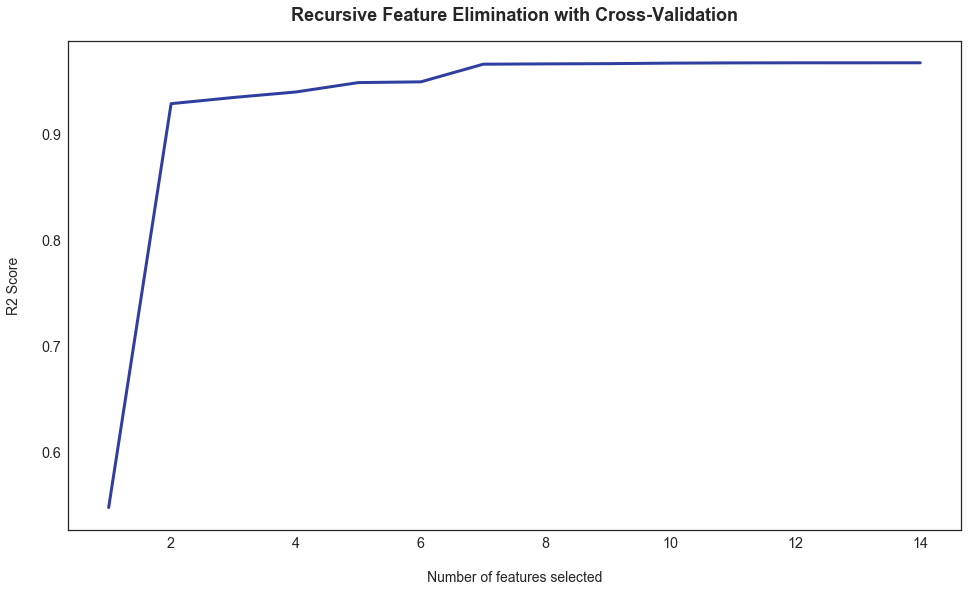

In [108]:
plt.figure(figsize=(16, 9))
plt.title('Recursive Feature Elimination with Cross-Validation', fontsize=18, fontweight='bold', pad=20)
plt.xlabel('Number of features selected', fontsize=14, labelpad=20)
plt.ylabel('R2 Score', fontsize=14, labelpad=20)
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_, color='#303F9F', linewidth=3)
plt.show()

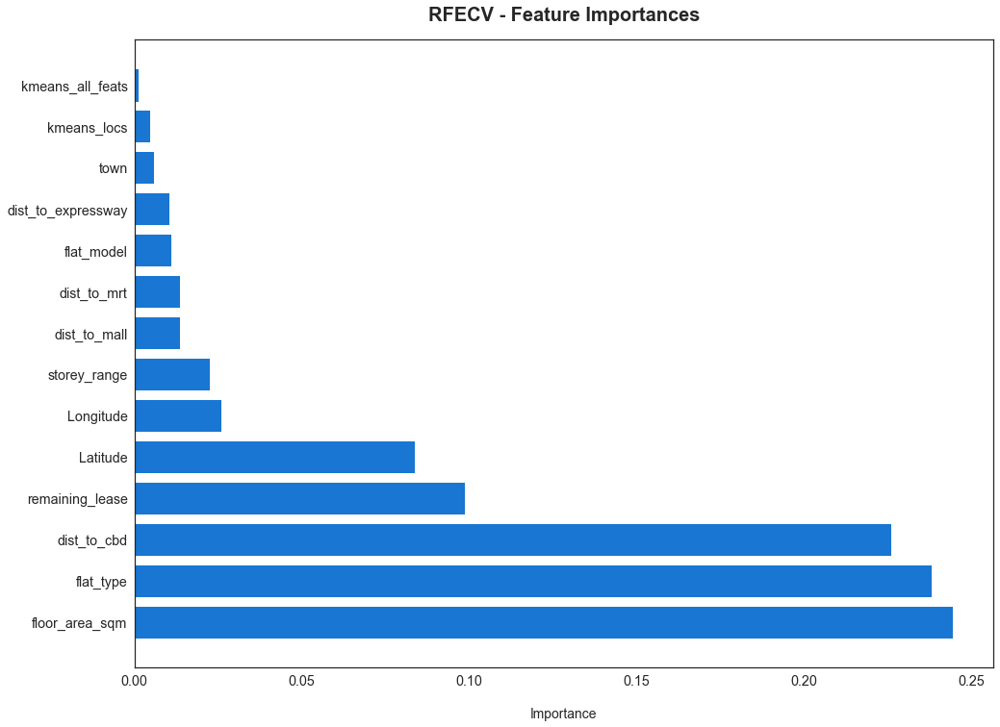

In [109]:
dset = pd.DataFrame()
dset['attr'] = X.columns
dset['importance'] = rfecv.estimator_.feature_importances_
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(16, 12))
plt.barh(y=dset['attr'], width=dset['importance'], color='#1976D2')
plt.title('RFECV - Feature Importances', fontsize=20, fontweight='bold', pad=20)
plt.xlabel('Importance', fontsize=14, labelpad=20)
plt.show()

The feature importances are plotted out, indicating again that floor area and distance to CBD has the greatest impact on resale prices, as shown earlier in the correlation plot and through PCA and K-Means Clustering with all the features.

#### Feature Selection using L1-Regularised Lasso Regression

Regularisation is the adding of a penalty term to the coefficients of a model to reduce the freedom of the model and avoid overfitting, improving its general performance on other unseen data. L1 regularisation or lasso can shrink the coefficients of the model to zero depending on the regularisation parameter. Thus, we can use this ability to perform feature selection. The model that overfits the least is the best choice for predictive power.

Since the regularisation penalty is made up of the sum of the absolute value of the coefficients, we need to scale the data so that the coefficients are all based on the same scale. This helps when the data has large differences between their ranges. Standardisation is also useful when the data has varying scales and the algorithm used assumes that the data has a Gaussian distribution.

In [110]:
scaler = StandardScaler()
scaler.fit(X)
X_tf = scaler.transform(X)

Computing regularization path using the LARS ...
.

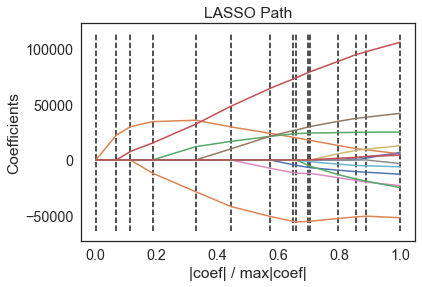

In [111]:
print("Computing regularization path using the LARS ...")
_, _, coefs = linear_model.lars_path(X_tf, y, method='lasso', verbose=True)

xx = np.sum(np.abs(coefs.T), axis=1)
xx /= xx[-1]

plt.plot(xx, coefs.T)
ymin, ymax = plt.ylim()
plt.vlines(xx, ymin, ymax, linestyle='dashed')
plt.xlabel('|coef| / max|coef|')
plt.ylabel('Coefficients')
plt.title('LASSO Path')
plt.axis('tight')
plt.show()

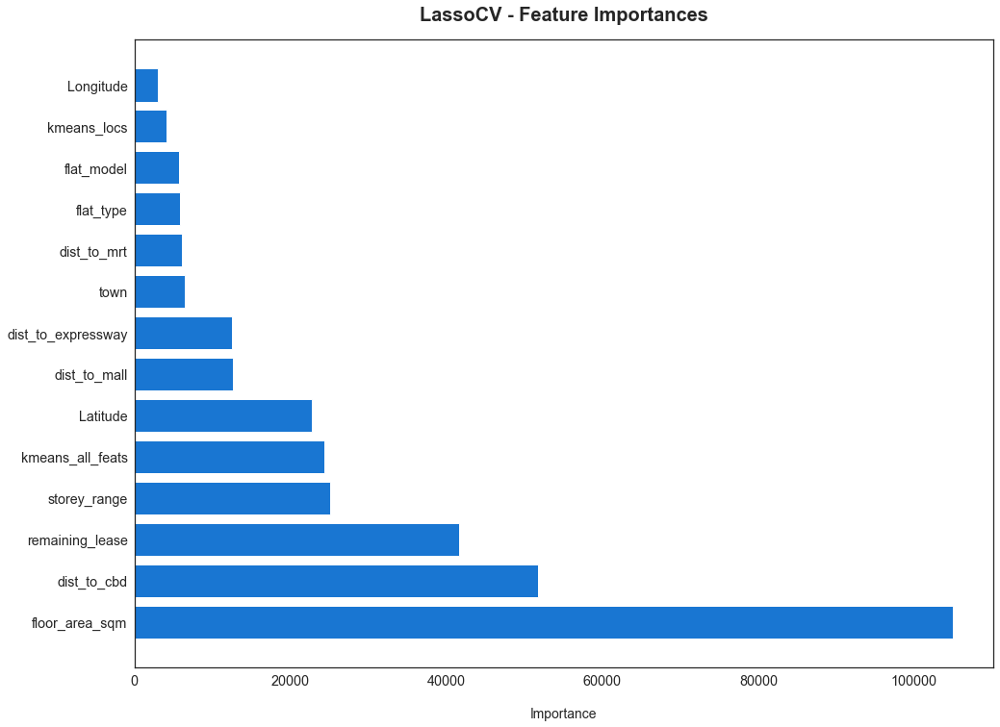

In [112]:
clf = LassoCV(cv=10, n_jobs=-1).fit(X_tf, y)
dset = pd.DataFrame()
dset['attr'] = X.columns
dset['importance'] = np.abs(clf.coef_)
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(16, 12))
plt.barh(y=dset['attr'], width=dset['importance'], color='#1976D2')
plt.title('LassoCV - Feature Importances', fontsize=20, fontweight='bold', pad=20)
plt.xlabel('Importance', fontsize=14, labelpad=20)
plt.show()

Just like what was seen in RFE, the floor area and distance to CBD has the greatest impact on resale prices.

By adjusting the regularisation parameter `alpha`, we can study the effect of the regularisation penalty as `alpha` becomes stronger. Over the range of `alpha` values, the R2-Score of the model can be plotted to derive the best selected coefficients and their corresponding value where the accuracy of the L1-regularised lasso regression is maximised, just like regression where we find the best penalty term and coefficients that maximises the mean-squared-error.

Computing regularization path ...
This took 4.064s


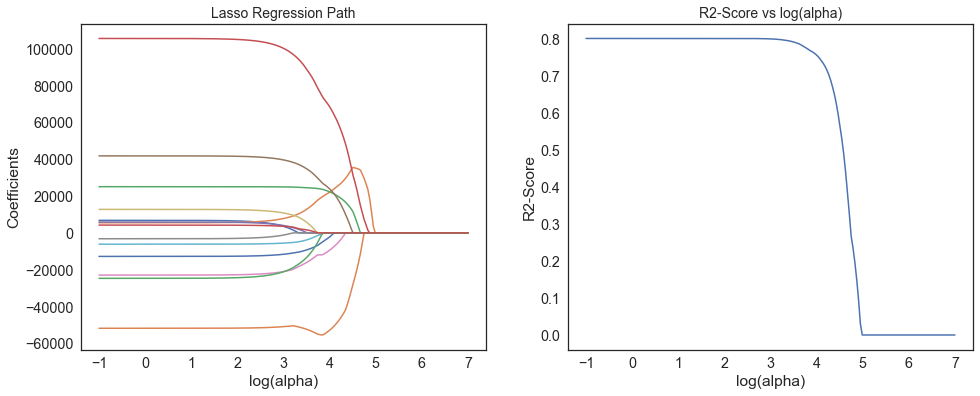

In [113]:
alphas = np.logspace(-1, 7, 200)

print("Computing regularization path ...")
start = time()
clf = linear_model.Lasso(tol=1e-6, max_iter=int(1e6), warm_start=True, random_state=42)
coefs_ = []
scores = []
intercepts =[]
for a in alphas:
    clf.set_params(alpha=a)
    clf.fit(X_tf, y)
    scores.append(clf.score(X_tf, y))
    coefs_.append(clf.coef_.ravel().copy())
    intercepts.append(clf.intercept_.ravel())
print("This took %0.3fs" % (time() - start))

coefs_ = np.array(coefs_)
accs = np.array(scores)
intercepts = np.array(intercepts)

plt.figure(figsize=(16, 6))
plt.subplot(121)
plt.plot(np.log10(alphas), coefs_)
ymin, ymax = plt.ylim()
plt.xlabel('log(alpha)')
plt.ylabel('Coefficients')
plt.title('Lasso Regression Path', fontsize=14)
plt.axis('tight')

plt.subplot(122)
plt.plot(np.log10(alphas), scores)
ymin, ymax = plt.ylim()
plt.xlabel('log(alpha)')
plt.ylabel('R2-Score')
plt.title('R2-Score vs log(alpha)', fontsize=14)
plt.axis('tight')
plt.show()

Plotting out the lasso regression path and the R2-Scores for each alpha value as it changes and reduces the coefficient of the feature to zero shows the impact of removing features on the R2-Score. Just like in RFE, the lasso model is most accurate with all the features included.

In [114]:
print("The optimal alpha value is {:0.7f} for an R2-Score of {:0.3f}".format(alphas[np.argmax(scores)], np.max(scores)))

The optimal alpha value is 0.1000000 for an R2-Score of 0.802


Feature selection via lasso regression also gives an alpha value of 0.1 for the most optimal R2-Score, as well as the coefficients for the linear model.

In [115]:
# Coefficients for lasso regression
coefs = pd.DataFrame(coefs_[np.argmax(scores)])
coefs.index = list(X.columns)
coefs.transpose()

,town,flat_type,storey_range,floor_area_sqm,flat_model,remaining_lease,Latitude,Longitude,dist_to_expressway,dist_to_mrt,dist_to_mall,dist_to_cbd,kmeans_all_feats,kmeans_locs
0,6799.103,5495.845,25075.520,105515.882,5880.689,41795.131,-22910.913,-3190.561,12757.269,-6144.319,-12773.680,-51776.969,-24683.785,4225.105


#### Prediction of resale flat prices (using one-hot encoding of categorical features)

Since the feature selection steps did not drop any features, we will use all the selected features in **X** to build and train our models. Categorical values in the dataset will be one-hot-encoded and numerically encoded to compare their performances on different models.

In [116]:
X_train, X_test, y_train, y_test = train_test_split(X_ohe, y, test_size = 0.5, random_state = 42) # One-Hot Encoding
Xn_train, Xn_test, yn_train, yn_test = train_test_split(X, y, test_size = 0.5, random_state = 42) # Numerical Encoding

A train-test split ratio of 50:50 is used since our dataset is substantially large. Cross-validation will also be employed later to verify the chosen model's performance.

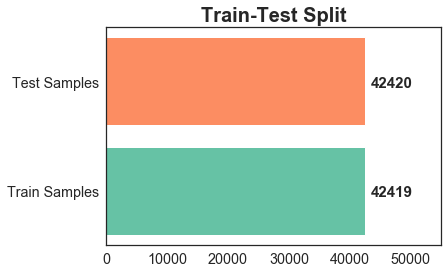

In [117]:
fig, ax = plt.subplots(figsize=(6, 4))
ax.barh(['Train Samples', 'Test Samples'], [X_train.shape[0], X_test.shape[0]], color=colorlist)
plt.title('Train-Test Split', fontsize=20, fontweight='bold') 
plt.xlim(0, 55000)
for i, v in enumerate([X_train.shape[0], X_test.shape[0]]):
    ax.text([X_train.shape[0], X_test.shape[0]][i]+1000, i-0.05, "%.f" % v, fontsize=15, fontweight='bold');

As previously explained, we need to standardise our data to prevent features with wide ranges from dominating the distance metric, or for models that assume that our data is normalised and follows a Gaussian distribution of mean 0 and variance of 1. Furthermore, gradient-descent based algorithms such as linear models and neural networks require the data to be scaled. This is to ensure that the gradient descent moves smoothly towards the minima and that the steps for gradient descent are updated at the same rate for all the features. (https://www.analyticsvidhya.com/blog/2020/04/feature-scaling-machine-learning-normalization-standardization/)

In [118]:
# Scale the data using StandardScaler()
scalerX = StandardScaler()
scalerX.fit(X_train)  # fit only on training data
X_train = scalerX.transform(X_train)
X_test = scalerX.transform(X_test)  # apply same transformation to test data

Different regressors are used so as to compare their performances with metrics that will be defined further down and the best performing model will be further evaluated with cross-validation. 

Linear models (OLS and lasso regression), tree-based models (decision tree and random forest), gradient boosting models (XGBoost) and neural nets (fully-connected feed-forward network) are trained with the data for this comparison.

In [119]:
# Define linear regressor and lasso regressor
lin_reg = LinearRegression()
lasso_reg = linear_model.Lasso(alpha=alphas[np.argmax(scores)], random_state=42)

# Define tree-based regressors
rf_reg = RandomForestRegressor(random_state=42)
dt_reg = DecisionTreeRegressor(random_state=42)

# Define boosting regressor
ada_reg = AdaBoostRegressor(random_state=42)
gb_reg = GradientBoostingRegressor(random_state=42)
xgb_reg = XGBRegressor(random_state=42)

The neural network used is a simple FCNN with 5 hidden layers with `relu` activation and a single output layer with a `linear` activation for the regression output. `mean_absolute_error` is used as the loss function and the optimiser used is the `adam` optimiser which has an adaptive learning rate and momentum.

In [120]:
# Define fully-connected feed-forward neural network
def fcnn_network():
    NN_model = Sequential()

    # Input Layer:
    NN_model.add(Dense(128, kernel_initializer='normal', input_dim = X_train.shape[1], activation='relu'))

    # Hidden Layers:
    NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))
    NN_model.add(Dense(512, kernel_initializer='normal', activation='relu'))
    NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))
    NN_model.add(Dense(128, kernel_initializer='normal', activation='relu'))
    NN_model.add(Dense(64, kernel_initializer='normal', activation='relu'))

    # Output Layer:
    NN_model.add(Dense(1, kernel_initializer='normal', activation='linear'))

    # Compile the network:
    NN_model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
    NN_model.summary()
    
    return NN_model

In [121]:
class KerasBatchRegressor(KerasRegressor, BaseEstimator):
    def __init__(self, model, **kwargs):
        super().__init__(model)
        self.fit_kwargs = kwargs
        self._estimator_type = 'regressor'
        
    def fit(self, X, y, *args, **kwargs):
        # taken from keras.wrappers.scikit_learn.KerasClassifier.fit
        self.model = self.build_fn(**self.filter_sk_params(self.build_fn))
        self.classes_ = np.unique(y)
        self.__history = self.model.fit(X, y, **self.fit_kwargs)

In [122]:
nn_model = KerasBatchRegressor(fcnn_network, batch_size=X_train.shape[0], epochs=300, validation_data=(X_test, y_test), verbose=1)

“LASSO” stands for Least Absolute Shrinkage and Selection Operator, and so it is a type of linear regression that uses shrinkage to shrink data towards a central point, such as the mean. The lasso procedure works well on simple and sparse models with fewer parameters, and is well-suited for models showing high levels of muticollinearity or when you want to automate certain parts of model selection, like variable selection/parameter elimination.

Lasso regression performs L1 regularisation, adding a penalty equal to the absolute value of the magnitude of coefficients, unlike ridge regression which penalizes sum of squared coefficients (L2 penalty). Regularisation is a way to avoid overfitting by penalizing high-valued regression coefficients, reducing parameters and shrinking or simplifying the model, helping it perform better at predictions. Regularisation adds penalties to more complex models and then sorts potential models from least overfit to greatest. The model with the lowest “overfitting” score is usually the best choice for predictive power.

Hence, the only difference in ridge and lasso loss functions is in the penalty terms.

α controls the strength of the L1 penalty, and can be tuned. α is also the amount of shrinkage:

* When α = 0, no parameters are eliminated. The estimate is equal to the one found with linear regression.
* As α increases, more and more coefficients are set to zero and eliminated (all coefficients are eliminated when α = ∞).
* As α increases, bias increases.
* As α decreases, variance increases.

In [123]:
lin_reg.fit(X_train, y_train)
lasso_reg.fit(X_train, y_train)

Lasso(alpha=0.1, random_state=42)

The decision tree algorithm builds a regression model in the form of a tree structure by breaking down a dataset into smaller subsets while the tree is incrementally developed with recursive partitioning from the root node, resulting in a tree with decision and leaf nodes by learning decision rules from features. For regression, the average label values are used.

Since the nodes are split based on a single feature, the split is not influenced by other features. This makes tree-based algorithms invariant to the scale of the features. As such, features do not need to be one-hot encoded or normalised/standardised.

In [124]:
dt_reg.fit(X_train, y_train)

DecisionTreeRegressor(random_state=42)

Random forests are a form of tree-based model ensembling by training many weak learners on random subsamples on the training data, which are then combined and averaged to make predictions for regression. This improves its generalisation performance due to randomness and decreases model variance and overfitting. It is a form of bootstrap aggregating to tree learners.

In [125]:
rf_reg.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

Boosting is also another type of ensemble method that combines several weak learners to produce a strong learner and aims to reduce model bias instead of variance. 

AdaBoost is a simple booster that trains an initial base regression tree with uniform weights and identify samples with large errors. These samples are re-weighted again with heavier weights and the model is retrained on the re-weighted dataset. At the end of every model prediction we end up boosting the weights of the instances with large errors so that the next model does a better job on them, and so on.

Gradient boosting attempts to fit a new predictor to the residual errors made by the previous predictor instead of tweaking the weights at every retraining. A new model is created using the errors calculated as the target variable and the objective is to find best split to minimise the error. The predictions made by this new model are combined with the predictions of the previous and the process is repeated.

Extreme gradient boosting (XGBoost) is a more advanced version of gradient boosting with higher predictive power and speed. It also includes regularisation to reduce overfitting and improve performance, as well as the ability to define a learning rate and running cross-validation at each iteration of the boosting to get the optimal number of iterations.

(https://medium.com/diogo-menezes-borges/boosting-with-adaboost-and-gradient-boosting-9cbab2a1af81)

In [126]:
gb_reg.fit(X_train, y_train)
ada_reg.fit(X_train, y_train)
xgb_reg.fit(X_train, y_train)

[08:22:23] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(random_state=42)

The neural network is trained for 300 epoches and the history plots are compared to ensure that the model is learning and converging.

In [127]:
history = nn_model.fit(X_train, y_train)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 128)               10112     
_________________________________________________________________
dense_2 (Dense)              (None, 256)               33024     
_________________________________________________________________
dense_3 (Dense)              (None, 512)               131584    
_________________________________________________________________
dense_4 (Dense)              (None, 256)               131328    
_________________________________________________________________
dense_5 (Dense)              (None, 128)               32896     
_________________________________________________________________
dense_6 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_7 (Dense)              (None, 1)                

Epoch 38/300
42419/42419 [==============================] - 0s 2us/step - loss: 425960.4375 - mean_absolute_error: 425960.4375 - val_loss: 423196.5838 - val_mean_absolute_error: 423196.5625
Epoch 39/300
42419/42419 [==============================] - 0s 2us/step - loss: 423358.5312 - mean_absolute_error: 423358.5312 - val_loss: 420069.4384 - val_mean_absolute_error: 420069.4375
Epoch 40/300
42419/42419 [==============================] - 0s 2us/step - loss: 420218.2188 - mean_absolute_error: 420218.2188 - val_loss: 416306.9515 - val_mean_absolute_error: 416306.9375
Epoch 41/300
42419/42419 [==============================] - 0s 2us/step - loss: 416439.7812 - mean_absolute_error: 416439.7812 - val_loss: 411793.4047 - val_mean_absolute_error: 411793.4062
Epoch 42/300
42419/42419 [==============================] - 0s 2us/step - loss: 411907.0312 - mean_absolute_error: 411907.0312 - val_loss: 406394.5173 - val_mean_absolute_error: 406394.5000
Epoch 43/300
42419/42419 [========================

Epoch 82/300
42419/42419 [==============================] - 0s 2us/step - loss: 61187.0586 - mean_absolute_error: 61187.0586 - val_loss: 57082.4359 - val_mean_absolute_error: 57082.4375
Epoch 83/300
42419/42419 [==============================] - 0s 2us/step - loss: 57010.6328 - mean_absolute_error: 57010.6328 - val_loss: 55145.9085 - val_mean_absolute_error: 55145.9062
Epoch 84/300
42419/42419 [==============================] - 0s 2us/step - loss: 54972.9688 - mean_absolute_error: 54972.9688 - val_loss: 55544.9490 - val_mean_absolute_error: 55544.9531
Epoch 85/300
42419/42419 [==============================] - 0s 2us/step - loss: 55310.2070 - mean_absolute_error: 55310.2070 - val_loss: 56828.9886 - val_mean_absolute_error: 56828.9883
Epoch 86/300
42419/42419 [==============================] - 0s 2us/step - loss: 56533.8203 - mean_absolute_error: 56533.8203 - val_loss: 57346.7532 - val_mean_absolute_error: 57346.7500
Epoch 87/300
42419/42419 [==============================] - 0s 2us/ste

Epoch 126/300
42419/42419 [==============================] - 0s 2us/step - loss: 38063.1445 - mean_absolute_error: 38063.1445 - val_loss: 38172.2551 - val_mean_absolute_error: 38172.2539
Epoch 127/300
42419/42419 [==============================] - 0s 2us/step - loss: 37787.3867 - mean_absolute_error: 37787.3867 - val_loss: 37871.6210 - val_mean_absolute_error: 37871.6211
Epoch 128/300
42419/42419 [==============================] - 0s 2us/step - loss: 37498.3242 - mean_absolute_error: 37498.3242 - val_loss: 37602.8442 - val_mean_absolute_error: 37602.8438
Epoch 129/300
42419/42419 [==============================] - 0s 2us/step - loss: 37242.4766 - mean_absolute_error: 37242.4766 - val_loss: 37380.1829 - val_mean_absolute_error: 37380.1836
Epoch 130/300
42419/42419 [==============================] - 0s 2us/step - loss: 37032.1406 - mean_absolute_error: 37032.1406 - val_loss: 37177.6668 - val_mean_absolute_error: 37177.6680
Epoch 131/300
42419/42419 [==============================] - 0s 2

Epoch 170/300
42419/42419 [==============================] - 0s 2us/step - loss: 31154.8398 - mean_absolute_error: 31154.8398 - val_loss: 31458.2313 - val_mean_absolute_error: 31458.2305
Epoch 171/300
42419/42419 [==============================] - 0s 2us/step - loss: 31071.9629 - mean_absolute_error: 31071.9629 - val_loss: 31377.6164 - val_mean_absolute_error: 31377.6152
Epoch 172/300
42419/42419 [==============================] - 0s 2us/step - loss: 30990.2188 - mean_absolute_error: 30990.2188 - val_loss: 31299.7395 - val_mean_absolute_error: 31299.7422
Epoch 173/300
42419/42419 [==============================] - 0s 2us/step - loss: 30909.6172 - mean_absolute_error: 30909.6172 - val_loss: 31224.6133 - val_mean_absolute_error: 31224.6133
Epoch 174/300
42419/42419 [==============================] - 0s 2us/step - loss: 30831.2129 - mean_absolute_error: 30831.2129 - val_loss: 31151.8243 - val_mean_absolute_error: 31151.8262
Epoch 175/300
42419/42419 [==============================] - 0s 2

Epoch 214/300
42419/42419 [==============================] - 0s 2us/step - loss: 28730.1934 - mean_absolute_error: 28730.1934 - val_loss: 29113.2347 - val_mean_absolute_error: 29113.2344
Epoch 215/300
42419/42419 [==============================] - 0s 2us/step - loss: 28694.2578 - mean_absolute_error: 28694.2578 - val_loss: 29078.0760 - val_mean_absolute_error: 29078.0762
Epoch 216/300
42419/42419 [==============================] - 0s 2us/step - loss: 28658.8203 - mean_absolute_error: 28658.8203 - val_loss: 29043.1399 - val_mean_absolute_error: 29043.1406
Epoch 217/300
42419/42419 [==============================] - 0s 2us/step - loss: 28623.8555 - mean_absolute_error: 28623.8555 - val_loss: 29008.7795 - val_mean_absolute_error: 29008.7793
Epoch 218/300
42419/42419 [==============================] - 0s 2us/step - loss: 28589.4473 - mean_absolute_error: 28589.4473 - val_loss: 28975.0671 - val_mean_absolute_error: 28975.0664
Epoch 219/300
42419/42419 [==============================] - 0s 2

Epoch 258/300
42419/42419 [==============================] - 0s 2us/step - loss: 27503.4434 - mean_absolute_error: 27503.4434 - val_loss: 27951.8141 - val_mean_absolute_error: 27951.8145
Epoch 259/300
42419/42419 [==============================] - 0s 2us/step - loss: 27481.4961 - mean_absolute_error: 27481.4961 - val_loss: 27931.8622 - val_mean_absolute_error: 27931.8633
Epoch 260/300
42419/42419 [==============================] - 0s 2us/step - loss: 27459.8223 - mean_absolute_error: 27459.8223 - val_loss: 27911.7553 - val_mean_absolute_error: 27911.7539
Epoch 261/300
42419/42419 [==============================] - 0s 2us/step - loss: 27438.1797 - mean_absolute_error: 27438.1797 - val_loss: 27891.8145 - val_mean_absolute_error: 27891.8164
Epoch 262/300
42419/42419 [==============================] - 0s 2us/step - loss: 27416.9316 - mean_absolute_error: 27416.9316 - val_loss: 27872.1615 - val_mean_absolute_error: 27872.1602
Epoch 263/300
42419/42419 [==============================] - 0s 2

In [128]:
def plot_history(history):
    history = pd.DataFrame(history.history)
    history.rename(columns = {'loss':'Training Loss', 
                          'val_loss':'Validation Loss', 
                          'mean_absolute_error':'Training Mean Absolute Error',
                          'val_mean_absolute_error':'Validation Mean Absolute Error'}, inplace = True)
    history.plot(y=['Training Loss', 'Validation Loss'], title='Loss', figsize=(14,4))
    history.plot(y=['Training Mean Absolute Error', 'Validation Mean Absolute Error'], title='Mean Absolute Error', figsize=(14,4));

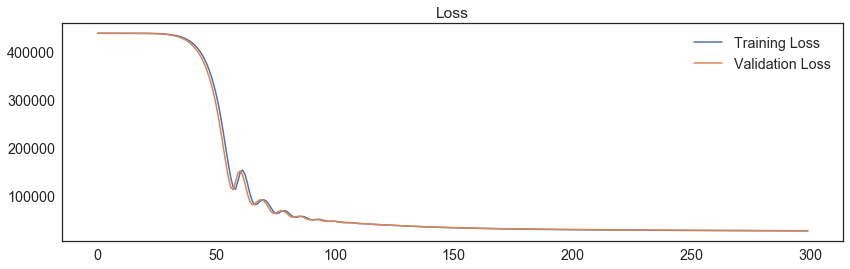

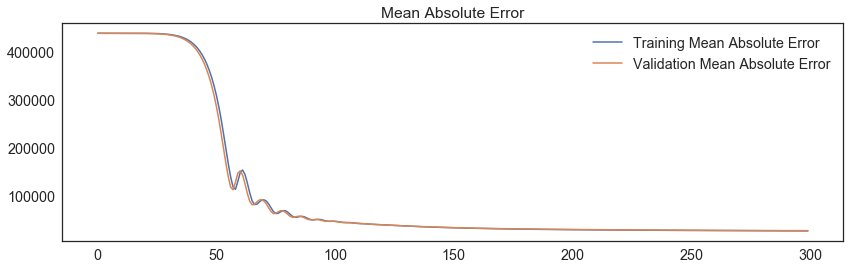

In [129]:
plot_history(nn_model.model.history)

Since the training and validation losses and mean absolute error scores converge over 300 epoches, the neural network model is likely successfully trained by the data inputs.

In [130]:
fitted_models = {
    "Linear Regression": lin_reg,
    "Lasso Regression": lasso_reg,
    "Decision Tree Regression": dt_reg,
    "Random Forest Regression": rf_reg,
    "AdaBoost Regression": ada_reg,
    "Gradient Boost Regression": gb_reg,
    "XGB Regression": xgb_reg,
    "Fully Connected Neural Network": nn_model
}

Define the metrics used for model evaluation.

In [131]:
mod_df_index = ['Mean squared error', 'RMSE', 'Scaled RMSE', 'Mean absolute error', 'Max error', 'Variance/R2 score']
mod_train = pd.DataFrame(index=mod_df_index)
mod_test = pd.DataFrame(index=mod_df_index)

In [132]:
def rmse_scaled(y_true, y_pred):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    scale = np.sqrt(np.mean(y_true**2))
    return rmse/scale

In [133]:
def calc_metrics_train(value):
    y_train_pred = value.predict(X_train)
    mse = mean_squared_error(y_train, y_train_pred)
    rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
    mae = mean_absolute_error(y_train, y_train_pred)
    max_err = max_error(y_train, y_train_pred)
    r2 = r2_score(y_train, y_train_pred)
    scaled_rsme = rmse_scaled(y_train, y_train_pred)
    return [mse, rmse, scaled_rsme, mae, max_err, r2]

def calc_metrics_test(value):
    y_test_pred = value.predict(X_test)
    mse = mean_squared_error(y_test, y_test_pred)
    rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
    mae = mean_absolute_error(y_test, y_test_pred)
    max_err = max_error(y_test, y_test_pred)
    r2 = r2_score(y_test, y_test_pred)
    scaled_rsme = rmse_scaled(y_test, y_test_pred)
    return [mse, rmse, scaled_rsme, mae, max_err, r2]

In [134]:
for key, value in fitted_models.items():
    all_models_train = np.asarray(calc_metrics_train(value))
    all_models_test = np.asarray(calc_metrics_test(value))
    mod_train[key] = all_models_train
    mod_test[key] = all_models_test

#### Performance of regression models on one-hot-encoded dataset

In [135]:
mod_train # Metrics for training set (One-Hot Encoding)

,Linear Regression,Lasso Regression,Decision Tree Regression,Random Forest Regression,AdaBoost Regression,Gradient Boost Regression,XGB Regression,Fully Connected Neural Network
Mean squared error,2391697841.945,2391572044.488,50326580.605,134673912.885,5516800805.616,1629189886.466,1643087353.708,1388526399.067
RMSE,48904.988,48903.702,7094.123,11604.909,74275.170,40363.224,40535.014,37262.936
Scaled RMSE,0.106,0.106,0.015,0.025,0.161,0.088,0.088,0.081
Mean absolute error,37049.164,37047.050,2507.096,8190.433,63224.931,29672.284,29853.798,26700.273
Max error,283345.918,282900.502,112000.000,133614.240,253745.407,263195.616,261227.188,270574.031
Variance/R2 score,0.883,0.883,0.998,0.993,0.730,0.920,0.920,0.932


In [136]:
mod_test # Metrics for test set (One-Hot Encoding)

,Linear Regression,Lasso Regression,Decision Tree Regression,Random Forest Regression,AdaBoost Regression,Gradient Boost Regression,XGB Regression,Fully Connected Neural Network
Mean squared error,2414470202.423,2414683835.454,1186421541.068,711330883.017,5570128678.043,1687146264.040,1700467953.454,1429403434.209
RMSE,49137.259,49139.433,34444.470,26670.787,74633.295,41074.886,41236.731,37807.452
Scaled RMSE,0.107,0.107,0.075,0.058,0.162,0.089,0.090,0.082
Mean absolute error,37150.888,37153.032,24224.593,19127.669,63509.656,30140.875,30319.546,27240.105
Max error,356249.918,355983.527,320000.000,286569.427,318091.762,283553.688,293781.125,284422.812
Variance/R2 score,0.880,0.880,0.941,0.965,0.724,0.916,0.916,0.929


From the above metrics tables for both training and test sets, the random forest model performs the best followed by decision tree and neural network. Random forest scored the lowest on scaled RSME (5.8% error proportion) and has the highest R2-Score of 0.965 on the test set, indicating that the random forest model that was built on the training data is a good fit on the test data since its R2-Score is close to 1. 

Although decision tree has a higher R2-Score and lower scaled RSME on the training data, the bagging ensembling method of random forest allows the model to reduce variance and hence reduce overfitting, resulting in a better test performance for random forest on unseen data due to its better generalisation ability.

#### Comparison with numerically-encoded categorical features

![Numerical Encoding Metrics](metrics_num_enc.jpg)

The models were retrained with numerical label encoding for the categorical features, showing the effect on non-standardised data on the different models. While the tree-based models (decision tree, random forest and boosting models) do not show much difference with one-hot and numerically-encoded features, the linear models and neural network suffer in performance without one-hot encoding. This is due to higher weightage being placed on categories with a bigger value, which skews the prediction by capturing an unwanted order in the relationship when there is supposed to be no order between each category.

Hence, tree-based models are robust to feature scaling and can be used without scaling or one-hot encoding.

The residual plots for the different regression models are also plotted below.

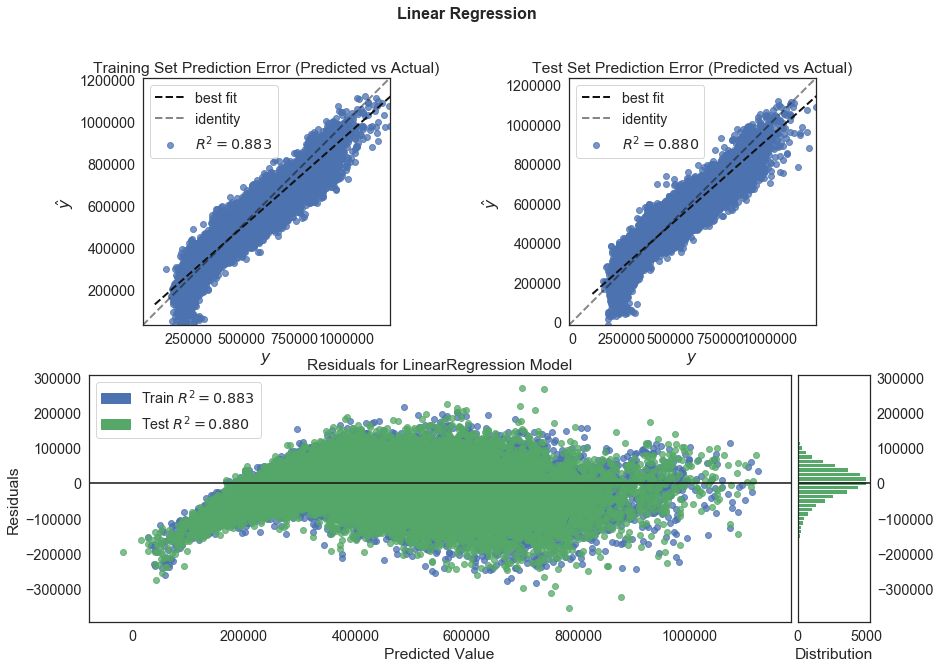

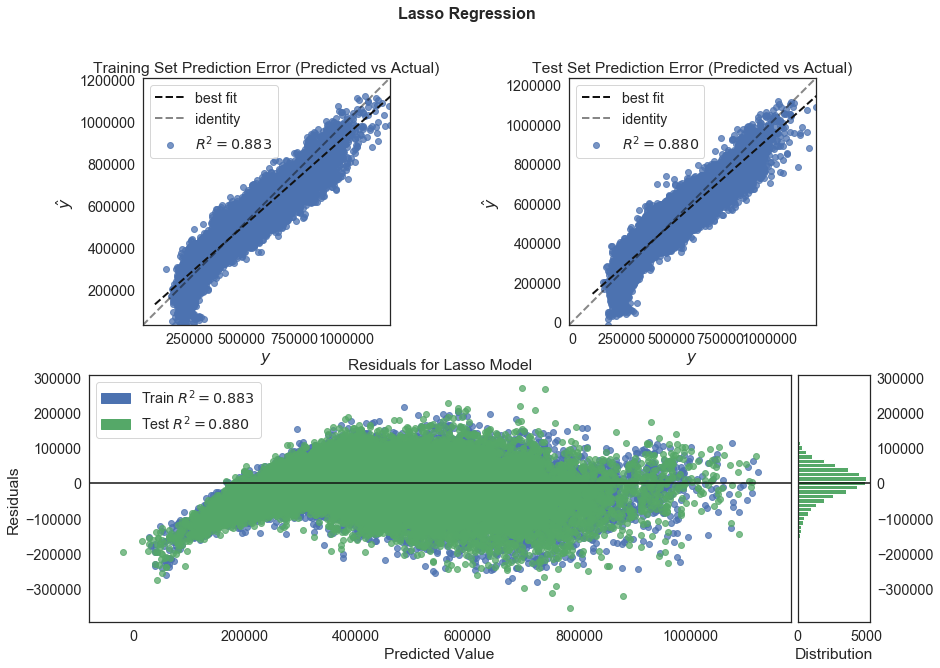

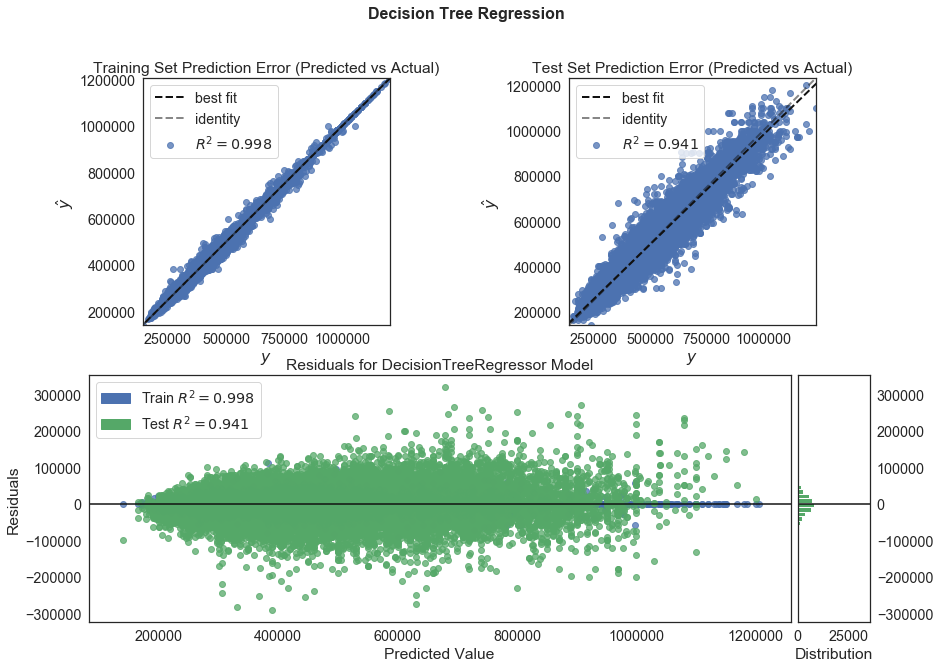

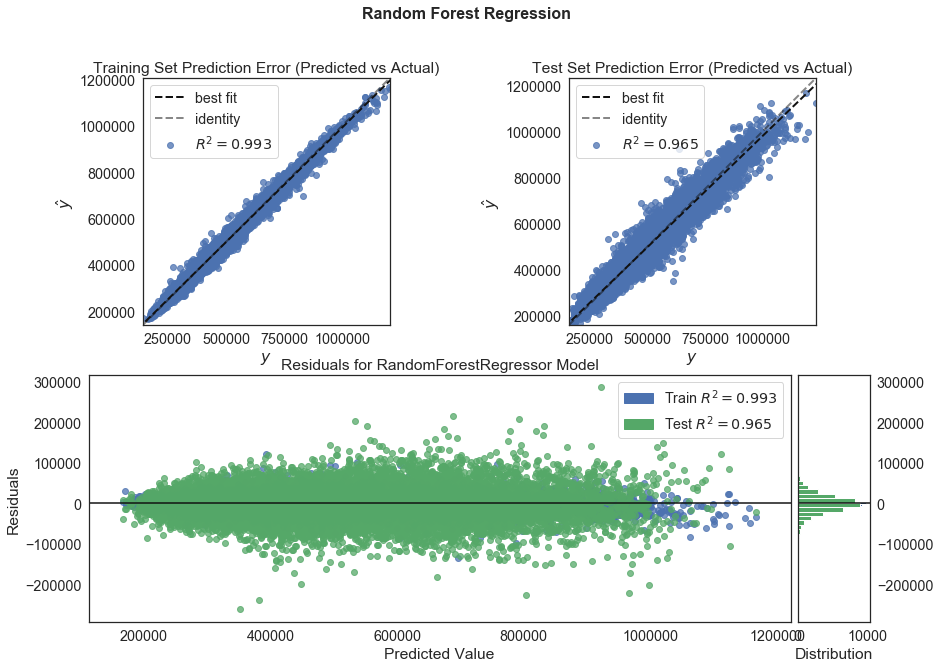

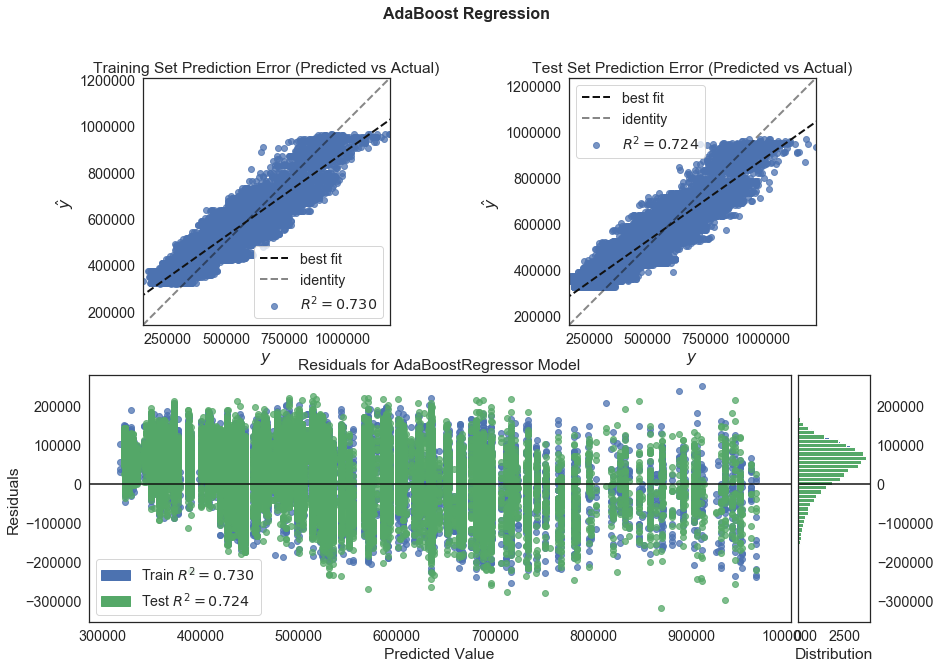

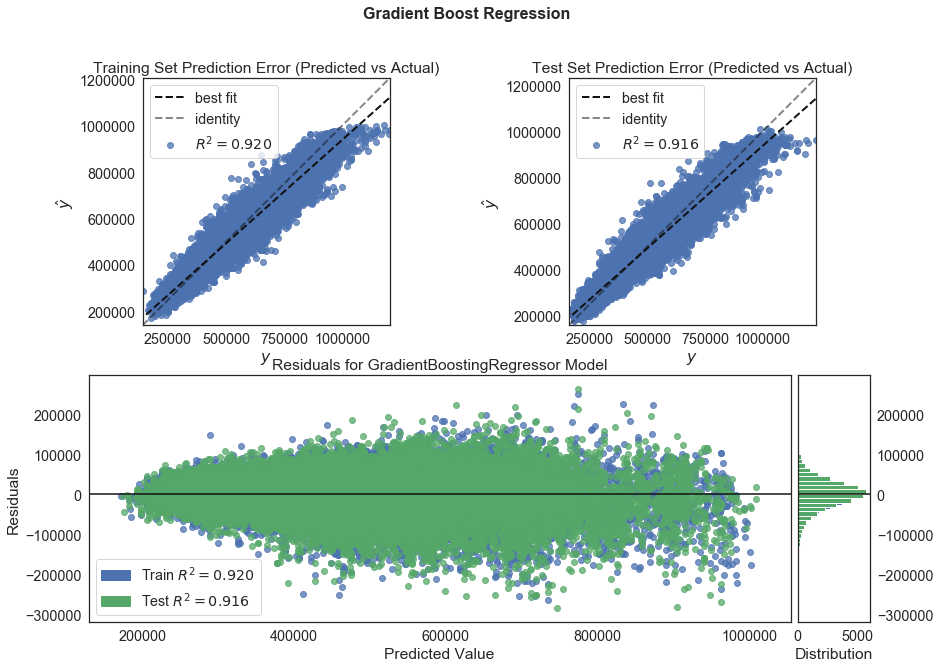

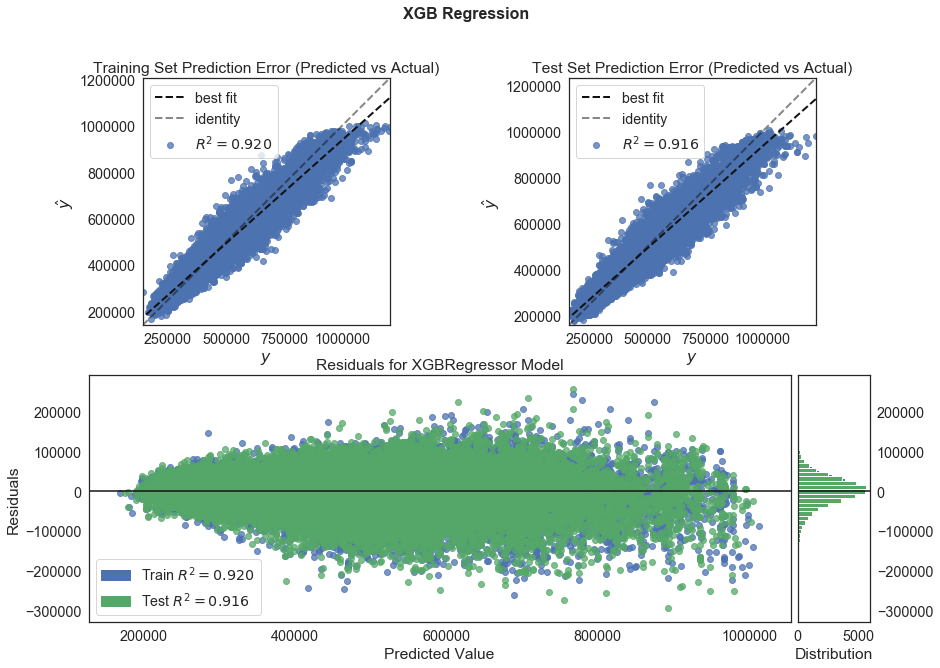

42419/42419 [==============================] - 2s 36us/step


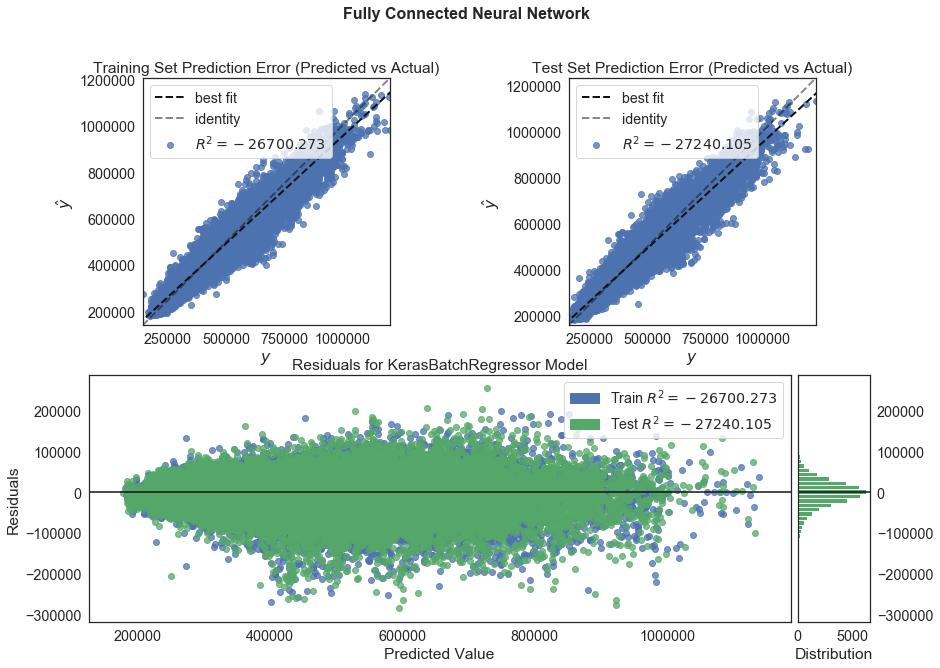

In [137]:
for key, value in islice(fitted_models.items(), None):
    fig = plt.figure(figsize=(14, 10))
    fig.suptitle(str(key), fontweight="bold", fontsize=16)

    ax1 = plt.subplot(212)
    visualizer = ResidualsPlot(value)
    visualizer.fit(X_train, y_train)  
    visualizer.score(X_test, y_test)  
    visualizer.finalize()                 

    ax2 = plt.subplot(222)
    visualizer = PredictionError(value)
    visualizer.fit(X_train, y_train)  
    visualizer.score(X_test, y_test)  
    visualizer.finalize()
    ax2.set_title('Test Set Prediction Error (Predicted vs Actual)')

    ax3 = plt.subplot(221)
    visualizer = PredictionError(value)
    visualizer.fit(X_train, y_train)  
    visualizer.score(X_train, y_train)  
    visualizer.finalize()   
    ax3.set_title('Training Set Prediction Error (Predicted vs Actual)')
    plt.show();

From the above plots, we can once again see that random forest performs the best since it has the best R2-Score. Ideally, the residuals should be distributed randomly and symmetrically across the zero line without large outliers or distinct patterns. Random forest has a residual plot that is tighter and more compact along the zero line as compared to the other models.

The linear models of OLS and lasso has a lower performance as seen from the heteroscedasticity within their residual plots. This means that the linear model is unable to properly fit the dataset due to some non-linear nature within, which shows up as a pattern within the error term. The same is observed in AdaBoost as well.

#### Validating Performance of Random Forest Model with k-Fold Cross Validation

The performance of the random forest regressor is further validated by performing a 10-fold cross-validation to observe the R2-Score distribution across different samples of the training data. This gives us a better understanding of the true performance of the model on different subsets of the data.

Cross-validation is a resampling technique used to evaluate machine learning models by splitting a randomly shuffled dataset into k groups and taking one group as the hold out or test group while training a model on the remaining groups. The model is evaluated on the test group and the process is repeated. This results in a less biased estimate of the model rather than a simple train-test split.

(https://machinelearningmastery.com/k-fold-cross-validation/)

In [138]:
scores = cross_val_score(rf_reg, X_train, y_train, cv=10)

Mean R2-Score: 0.9644312205690069
Std R2-Score: 0.0015683661437284884


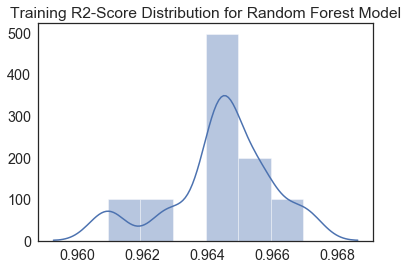

In [139]:
print(f'Mean R2-Score: {np.mean(scores)}')
print(f'Std R2-Score: {np.std(scores)}')
plt.title("Training R2-Score Distribution for Random Forest Model")
sns.distplot(scores);

From the 10-fold cross-validation, we observe that the performance of the model on the training set better reflects the test performance on the unseen data since the mean CV R2-Score and the test R2-Score are close to each other at 0.965. Thus, cross-validation helps us to more accurately measure the performance of the model before applying it on unseen data.

In [140]:
print(f'Train R2-Score: {rf_reg.score(X_train, y_train)}')
print(f'Mean CV R2-Score: {np.mean(scores)}')
print(f'Test R2-Score: {rf_reg.score(X_test, y_test)}')

Train R2-Score: 0.9934139849539299
Mean CV R2-Score: 0.9644312205690069
Test R2-Score: 0.9647402648415574


We can pick a sample out of the predicted resale prices and compare it with the actual prices in the test set to observe the variance of the residuals and how close our predictions are with the trained random forest model.

In [141]:
y_test_pred = rf_reg.predict(X_test)
actual_vs_pred = np.vstack((y_test_pred, y_test))
resale_price_df = pd.DataFrame(actual_vs_pred).transpose()
resale_price_df.columns = ["Predicted Price", "Actual Price"]
resale_price_df['Residuals'] = resale_price_df['Actual Price'] - resale_price_df['Predicted Price']
resale_price_df = resale_price_df.sample(n=60, random_state=42).round(3).reset_index(drop=True)
data_from_Xtest = Xt_test.iloc[resale_price_df.sample(n=60, random_state=42).round(3).index][['town', 'flat_type', 'storey_range', 'floor_area_sqm', 'remaining_lease']].reset_index(drop=True)
pd.concat([data_from_Xtest, resale_price_df], axis=1)

,town,flat_type,storey_range,floor_area_sqm,remaining_lease,Predicted Price,Actual Price,Residuals
0,HOUGANG,EXECUTIVE,04 TO 06,150.000,74,471216.487,475000.000,3783.513
1,BEDOK,4 ROOM,04 TO 06,84.000,67,545580.920,565000.000,19419.080
2,YISHUN,4 ROOM,07 TO 09,84.000,69,384014.980,388000.000,3985.020
3,SENGKANG,4 ROOM,10 TO 12,92.000,90,504664.078,475000.000,-29664.078
4,SENGKANG,5 ROOM,10 TO 12,113.000,94,392874.713,408000.000,15125.287
5,ANG MO KIO,3 ROOM,04 TO 06,73.000,61,336408.867,320000.000,-16408.867
6,SENGKANG,4 ROOM,10 TO 12,95.000,92,394870.000,395000.000,130.000
7,WOODLANDS,3 ROOM,04 TO 06,73.000,76,327796.040,390000.000,62203.960
8,CHOA CHU KANG,4 ROOM,10 TO 12,104.000,81,437422.720,433000.000,-4422.720
9,ANG MO KIO,3 ROOM,04 TO 06,68.000,58,529328.446,528888.000,-440.446


Generally, the residuals show a wide range of variance from the actual prices, but it is also noted that the random forest model is already the best performing model with the highest R2-Score. In some townships, the difference can merely be a few hundred to a few thousand dollars off the actual price, which is a small sum compared to the actual resale price. However, some flats can differ in value of in the order of tens of thousands. Nevertheless, the model appears to be fairly accurate but results should always be treated as a guide instead of relying on them to be completely accurate as there may be other forces that affect resale prices, such as economic outlook and availability of alternative housing choices for a particular year that may not be captured in this dataset.

#### Tuning Random Forest Model

The random forest model can be further tuned from its default values to improve its performance. However, since the dataset is very large, this takes very long. As such, only a 3-fold cross-validation is used for the grid search, with 3 different hyperparameters to be tuned.

In [142]:
param_dict={'n_estimators': np.arange(100, 300, 5), 
            'min_samples_leaf': [1, 2, 5],
            'min_samples_split': [1, 2, 5]} 

rf_grid = GridSearchCV(estimator = rf_reg, param_grid=param_dict, n_jobs=-1, cv=3, verbose=1)
rf_tuned = rf_grid.fit(X_train, y_train) 

Fitting 3 folds for each of 360 candidates, totalling 1080 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 152 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 402 tasks      | elapsed:  7.8min
[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed: 15.7min
[Parallel(n_jobs=-1)]: Done 1080 out of 1080 | elapsed: 23.6min finished


The best parameters after tuning are obtained as such and applied on the training and test set to evaluate the performance of the tuned model.

In [143]:
rf_grid.best_params_

{'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 280}

In [144]:
y_hat_train = rf_tuned.predict(X_train)
y_hat_test = rf_tuned.predict(X_test)

In [145]:
print(
    f'Scaled RMSE: \n {rmse_scaled(y_train, y_hat_train)} (Train) \
    \n {rmse_scaled(y_test, y_hat_test)} (Test) \n\
    \nRMSE: \n {np.sqrt(mean_squared_error(y_train, y_hat_train))} (Train) \
    \n {np.sqrt(mean_squared_error(y_test, y_hat_test))} (Test) \n\
    \nR2 Score: \n {r2_score(y_train, y_hat_train)} (Train) \
    \n {r2_score(y_test, y_hat_test)} (Test) \n\
    \nMean Absolute Error: \n {mean_absolute_error(y_train, y_hat_train)} (Train) \
    \n {mean_absolute_error(y_test, y_hat_test)} (Test) \n\
    \nMean Squared Error: \n {mean_squared_error(y_train, y_hat_train)} (Train) \
    \n {mean_squared_error(y_test, y_hat_test)} (Test) \n\
    \nMax Error: \n {max_error(y_train, y_hat_train)} (Train) \
    \n {max_error(y_test, y_hat_test)} (Test)'
)

Scaled RMSE: 
 0.030844194670120277 (Train)     
 0.057308735965033754 (Test) 
    
RMSE: 
 14191.718814363925 (Train)     
 26339.207879944985 (Test) 
    
R2 Score: 
 0.9901506122398978 (Train)     
 0.9656115341442105 (Test) 
    
Mean Absolute Error: 
 10243.331267681499 (Train)     
 18888.995032802824 (Test) 
    
Mean Squared Error: 
 201404882.905971 (Train)     
 693753871.7429559 (Test) 
    
Max Error: 
 147225.9003514737 (Train)     
 283682.4029591838 (Test)


From the above metrics, the R2-Score and the Scaled RSME does not seem to differ much from the untuned model, thus tuning in this case did not provide a significant level of performance increase from the untuned model. However, with greater computational resources, it is possible to evaluate more hyperparameters in the grid search or tune the other tree-based models, boosting models and neural network for better performance.
#### Model Stacking

A simple model stacking can also be done to improve the performance of individual regressors and averaging them into a single model, much like ensembling weak learners to form a stronger learner.

In [152]:
from sklearn.ensemble import StackingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR

level0 = list()
level0.append(('knn', KNeighborsRegressor()))
level0.append(('cart', DecisionTreeRegressor()))
level0.append(('svm', SVR()))
# define meta learner model
level1 = LinearRegression()
# define the stacking ensemble
model_stk = StackingRegressor(estimators=level0, final_estimator=level1, cv=5)
# fit the model on all available data
model_stk.fit(X_train, y_train)

StackingRegressor(cv=5,
                  estimators=[('knn', KNeighborsRegressor()),
                              ('cart', DecisionTreeRegressor()),
                              ('svm', SVR())],
                  final_estimator=LinearRegression())

In [153]:
y_hat_train = model_stk.predict(X_train)
y_hat_test = model_stk.predict(X_test)

In [154]:
print(
    f'Scaled RMSE: \n {rmse_scaled(y_train, y_hat_train)} (Train) \
    \n {rmse_scaled(y_test, y_hat_test)} (Test) \n\
    \nRMSE: \n {np.sqrt(mean_squared_error(y_train, y_hat_train))} (Train) \
    \n {np.sqrt(mean_squared_error(y_test, y_hat_test))} (Test) \n\
    \nR2 Score: \n {r2_score(y_train, y_hat_train)} (Train) \
    \n {r2_score(y_test, y_hat_test)} (Test) \n\
    \nMean Absolute Error: \n {mean_absolute_error(y_train, y_hat_train)} (Train) \
    \n {mean_absolute_error(y_test, y_hat_test)} (Test) \n\
    \nMean Squared Error: \n {mean_squared_error(y_train, y_hat_train)} (Train) \
    \n {mean_squared_error(y_test, y_hat_test)} (Test) \n\
    \nMax Error: \n {max_error(y_train, y_hat_train)} (Train) \
    \n {max_error(y_test, y_hat_test)} (Test)'
)

Scaled RMSE: 
 0.030537894306928708 (Train)     
 0.06539197248024396 (Test) 
    
RMSE: 
 14050.786989959273 (Train)     
 30054.279296749322 (Test) 
    
R2 Score: 
 0.9903452609547793 (Train)     
 0.9552266059236639 (Test) 
    
Mean Absolute Error: 
 9829.530131270858 (Train)     
 21565.28337102204 (Test) 
    
Mean Squared Error: 
 197424615.0372088 (Train)     
 903259704.047015 (Test) 
    
Max Error: 
 125717.93381387647 (Train)     
 245846.0486399762 (Test)


The R2-Score on the test set using model stacking has been improved but still loses out to the random forest model. Still, it showcases the ability of model stacking or ensembling to improve upon the performance of individual weak learners.


# Conclusion

From the results shown in unsupervised learning with PCA and K-Means Clustering, important features are usually ranked highly on the top few principal components or clustered together. This also agrees with feature selection methods using RFE and lasso regression. Common important features identified using these methods are floor size, distance to CBD, flat type and remaining lease. These features impact the resale prices of the flats the most.

Different regression methods were trained and evaluated with the data using one-hot and numerical encoding. Tree-based methods were found to be invariant to feature scaling and encoding, and are robust to different scales within raw data. Thus, they can be applied quickly on data without much feature engineering to gauge the initial model performance. Neural networks also performed decently on the dataset without tuning, but this method requires data to be scaled and normalised for the best performance. Further tuning of the model architecture and hyperparameters such as adding dropout and regularisation or using different activation functions and learning rates can also be done to improve its performance, but this may be computationally intensive due to the size of the dataset.